In [263]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
from datetime import datetime, timedelta
import os
import itertools

In [264]:
pd.options.display.max_columns = None

In [265]:
dati = pd.read_csv('bitcoin_data.csv')
dati

,Timestamp,Price
0,2013-04-28 00:00:00.000,135.300000
1,2013-04-29 00:00:00.000,141.960000
2,2013-04-30 00:00:00.000,135.300000
3,2013-05-01 00:00:00.000,117.000000
4,2013-05-02 00:00:00.000,103.430000
...,...,...
3875,2023-12-09 00:00:00.000,44202.176109
3876,2023-12-10 00:00:00.000,43745.491992
3877,2023-12-11 00:00:00.000,43757.959938
3878,2023-12-12 00:00:00.000,41200.962726


In [266]:
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

In [267]:
dati.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3880 entries, 0 to 3879
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Timestamp  3880 non-null   datetime64[ns]
 1   Price      3880 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 60.8 KB


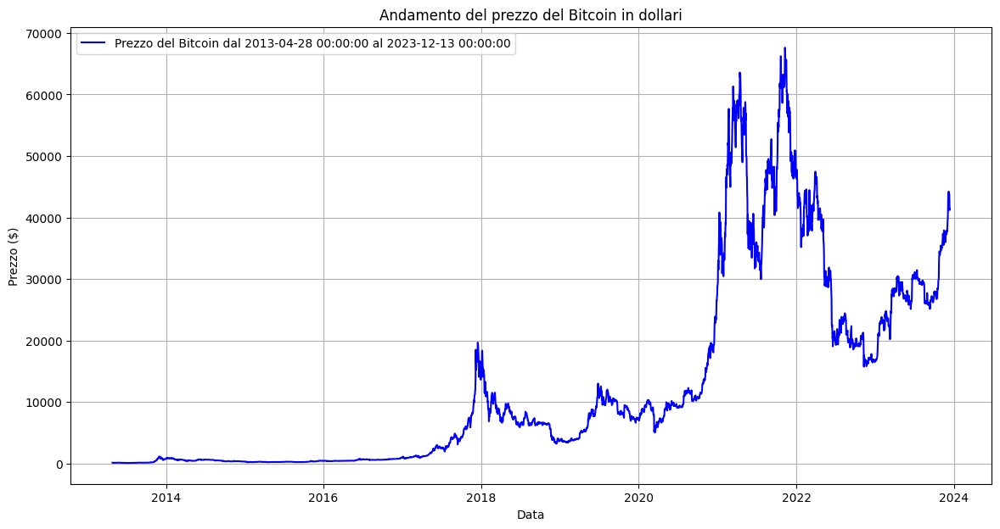

In [268]:
x = dati['Timestamp']
y = dati['Price']

plt.figure(figsize=(14, 7))
plt.plot(x, y, label=f"Prezzo del Bitcoin dal {str(x.iloc[0])} al {str(x.iloc[-1])}", color='blue')
plt.title('Andamento del prezzo del Bitcoin in dollari')
plt.xlabel('Data')
plt.ylabel('Prezzo ($)')
plt.legend()
plt.grid(True)
plt.show()

### Strategia Giacomo semplice (ritiro tutto ciò che eccede l'investimento di base, e lo faccio ogni tempo_controllo giorni)

In [269]:
dati = pd.read_csv('bitcoin_data.csv')
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

In [270]:
data_inizio = '2013-04-28'

In [271]:
dati[dati['Timestamp'] == data_inizio]

,Timestamp,Price
0,2013-04-28,135.3


In [272]:
indice_inizio = dati[dati['Timestamp'] == data_inizio].index[0]
indice_inizio

0

In [273]:
dati = dati[indice_inizio:]

In [274]:
dati = dati.reset_index(drop=True)

In [275]:
dati

,Timestamp,Price
0,2013-04-28,135.300000
1,2013-04-29,141.960000
2,2013-04-30,135.300000
3,2013-05-01,117.000000
4,2013-05-02,103.430000
...,...,...
3875,2023-12-09,44202.176109
3876,2023-12-10,43745.491992
3877,2023-12-11,43757.959938
3878,2023-12-12,41200.962726


In [276]:
dollari_in_banca = 10000
deposito_YP = 0
investimento_base = 100
tempo_controllo = 7
bitcoin_YP = 0
bitcoin_YP_in_dollari = 0
dollari_investiti = investimento_base
ricarica = 0
tempo_ricarica = 9999
prezzo_attuale = dati['Price'][0]
prezzo_iniziale = dati['Price'][0]

In [277]:
def bitcoin_in_dollari(bitcoin, prezzo_bitcoin):
    return bitcoin * prezzo_bitcoin

def dollari_in_bitcoin(euro, prezzo_bitcoin):
    return euro / prezzo_bitcoin

In [278]:
# Ricarica iniziale del deposito di YP
dollari_in_banca -= investimento_base
deposito_YP += investimento_base

# Acquisto bitcoin su YP
deposito_YP -= investimento_base
bitcoin_YP += dollari_in_bitcoin(investimento_base, prezzo_attuale)
bitcoin_YP_in_dollari = investimento_base

In [279]:
tabella_finale = dati.copy()
tabella_finale.rename(columns={'Timestamp': 'Data'}, inplace=True)
tabella_finale.rename(columns={'Price': 'Prezzo bitcoin in $'}, inplace=True)
tabella_finale['Deposito su YP in $'] = 0
tabella_finale['Bitcoin su YP'] = 0
tabella_finale['Bitcoin su YP in $'] = 0
tabella_finale['Ritiro in $'] = 0
tabella_finale['Soldi in banca in $'] = dollari_in_banca

In [280]:
for t in range(len(dati)):
        prezzo_attuale = tabella_finale['Prezzo bitcoin in $'][t]

        if (t+1) % tempo_controllo == 0:
                if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
                        ritiro_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base
                        tabella_finale['Ritiro in $'][t] = ritiro_in_dollari
                        bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
                        bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                        deposito_YP += ritiro_in_dollari

        if t == 0:
                tabella_finale['Deposito su YP in $'][t] = deposito_YP
                tabella_finale['Bitcoin su YP'][t] = bitcoin_YP
                tabella_finale['Bitcoin su YP in $'][t] = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
        else:
                tabella_finale['Deposito su YP in $'][t] = deposito_YP
                tabella_finale['Bitcoin su YP'][t] = bitcoin_YP
                tabella_finale['Bitcoin su YP in $'][t] = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\124352350.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Deposito su YP in $'][t] = deposito_YP
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\124352350.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Bitcoin su YP'][t] = bitcoin_YP
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\124352350.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vie

In [281]:
tabella_finale['Data'] = tabella_finale['Data'].dt.strftime('%d/%m/%Y')

In [282]:
tabella_finale

,Data,Prezzo bitcoin in $,Deposito su YP in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro in $,Soldi in banca in $
0,28/04/2013,135.300000,0.000000,0.739098,100.000000,0.0,9900
1,29/04/2013,141.960000,0.000000,0.739098,104.922395,0.0,9900
2,30/04/2013,135.300000,0.000000,0.739098,100.000000,0.0,9900
3,01/05/2013,117.000000,0.000000,0.739098,86.474501,0.0,9900
4,02/05/2013,103.430000,0.000000,0.739098,76.444937,0.0,9900
...,...,...,...,...,...,...,...
3875,09/12/2023,44202.176109,697.904994,0.001523,67.331096,0.0,9900
3876,10/12/2023,43745.491992,697.904994,0.001523,66.635450,0.0,9900
3877,11/12/2023,43757.959938,697.904994,0.001523,66.654442,0.0,9900
3878,12/12/2023,41200.962726,697.904994,0.001523,62.759489,0.0,9900


In [283]:
tabella_finale[tabella_finale['Deposito su YP in $'] > 697]

,Data,Prezzo bitcoin in $,Deposito su YP in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro in $,Soldi in banca in $
3121,15/11/2021,65648.977791,697.904994,0.001523,100.000000,3.951892,9900
3122,16/11/2021,63933.835443,697.904994,0.001523,97.387404,0.000000,9900
3123,17/11/2021,60448.562513,697.904994,0.001523,92.078452,0.000000,9900
3124,18/11/2021,60603.655867,697.904994,0.001523,92.314698,0.000000,9900
3125,19/11/2021,56987.322339,697.904994,0.001523,86.806108,0.000000,9900
...,...,...,...,...,...,...,...
3875,09/12/2023,44202.176109,697.904994,0.001523,67.331096,0.000000,9900
3876,10/12/2023,43745.491992,697.904994,0.001523,66.635450,0.000000,9900
3877,11/12/2023,43757.959938,697.904994,0.001523,66.654442,0.000000,9900
3878,12/12/2023,41200.962726,697.904994,0.001523,62.759489,0.000000,9900


In [284]:
tabella_finale['Data'] = pd.to_datetime(tabella_finale['Data'])

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1791676333.py:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  tabella_finale['Data'] = pd.to_datetime(tabella_finale['Data'])


In [285]:
tabella_finale.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3880 entries, 0 to 3879
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Data                 3880 non-null   datetime64[ns]
 1   Prezzo bitcoin in $  3880 non-null   float64       
 2   Deposito su YP in $  3880 non-null   float64       
 3   Bitcoin su YP        3880 non-null   float64       
 4   Bitcoin su YP in $   3880 non-null   float64       
 5   Ritiro in $          3880 non-null   float64       
 6   Soldi in banca in $  3880 non-null   int64         
dtypes: datetime64[ns](1), float64(5), int64(1)
memory usage: 212.3 KB


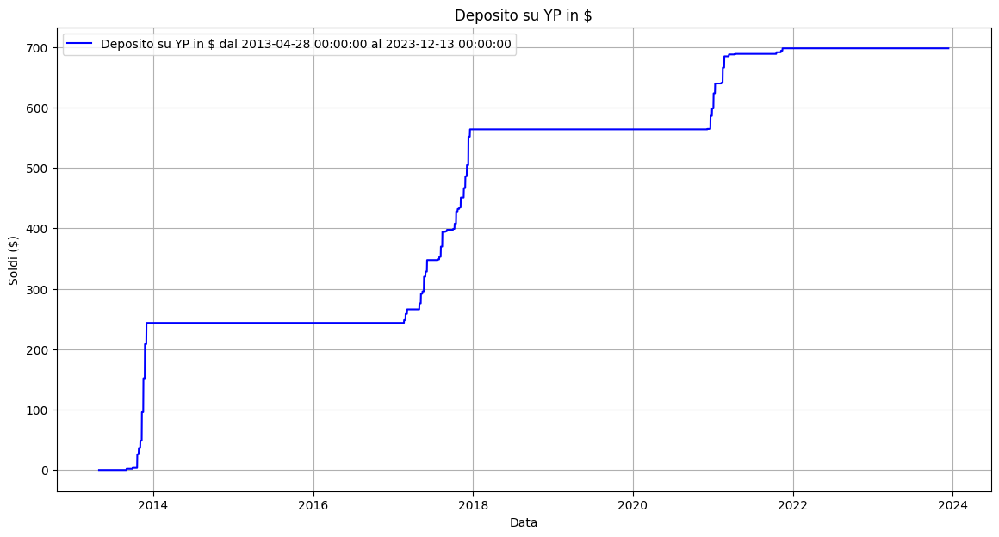

In [286]:
x = dati['Timestamp']
y = tabella_finale['Deposito su YP in $']

plt.figure(figsize=(14, 7))
plt.plot(x, y, label=f"Deposito su YP in $ dal {str(x.iloc[0])} al {str(x.iloc[-1])}", color='blue')
plt.title('Deposito su YP in $')
plt.xlabel('Data')
plt.ylabel('Soldi ($)')
plt.legend()
plt.grid(True)
plt.show()

### Strategia Giacomo con ritiro parziale dell'eccesso rispetto all'investimento di base

In [287]:
dati = pd.read_csv('bitcoin_data.csv')
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

### Strategia inventata da me

In [288]:
dati = pd.read_csv('bitcoin_data.csv')
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

### Strategia del VA

In [289]:
dati = pd.read_csv('bitcoin_data.csv')
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

In [290]:
data_inizio = '2020-02-01'
data_fine = '2021-11-09'

In [291]:
data1 = datetime.strptime(data_inizio, '%Y-%m-%d')
data2 = datetime.strptime(data_fine, '%Y-%m-%d')
lunghezza_periodo = (data2-data1).days
lunghezza_periodo

647

In [292]:
dati[dati['Timestamp'] == data_inizio]

,Timestamp,Price
2468,2020-02-01,9308.060286


In [293]:
indice_inizio = dati[dati['Timestamp'] == data_inizio].index[0]
indice_inizio

2468

In [294]:
indice_fine = dati[dati['Timestamp'] == data_fine].index[0]
indice_fine

3115

In [295]:
dati = dati[indice_inizio:indice_fine + 1]

In [296]:
dati = dati.reset_index(drop=True)

In [297]:
dati

,Timestamp,Price
0,2020-02-01,9308.060286
1,2020-02-02,9363.224207
2,2020-02-03,9338.416632
3,2020-02-04,9308.912702
4,2020-02-05,9179.959281
...,...,...
643,2021-11-05,61601.743572
644,2021-11-06,61247.384942
645,2021-11-07,61661.358664
646,2021-11-08,63153.230193


In [298]:
tabella_finale = dati.copy()
tabella_finale.rename(columns={'Timestamp': 'Data'}, inplace=True)
tabella_finale.rename(columns={'Price': 'Prezzo bitcoin in $'}, inplace=True)
tabella_finale['Deposito su YP in $'] = 0
tabella_finale['Deposito su YP + liquidità cumulativa in $'] = 0
tabella_finale['Bitcoin su YP'] = 0
tabella_finale['Bitcoin su YP in $'] = 0
tabella_finale['Ritiro per strategia Giacomo in $'] = 0
tabella_finale['Soldi in banca in $'] = dollari_in_banca
tabella_finale['Vendita effettuata'] = False
tabella_finale['Liquidità istantanea'] = 0
tabella_finale['Liquidità cumulativa'] = 0
tabella_finale['Obiettivo'] = 0 # La popolo successivamente
tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'] = 0
tabella_finale['Ricarica istantanea per VA'] = 0
tabella_finale['Ricarica cumulativa per VA'] = 0
tabella_finale['Tasse pagate istantanee'] = 0
tabella_finale['Tasse pagate cumulative'] = 0

<h6> Inizializzazione variabili </h6>

In [299]:
dollari_in_banca = 100000
deposito_YP = 0
deposito_iniziale = 1000
bitcoin_YP = 0
bitcoin_YP_in_dollari = 0
perc_tassa_acquisto = 0.002
liquidità_ist = 0
liquidità_cumulativa = 0
ricarica_cumulativa = 0
tasse_pagate_ist = 0
tasse_pagate = 0
prezzo_attuale = tabella_finale['Prezzo bitcoin in $'][0]

# Variabili
strategia_giacomo = False
strategia_VA = True
investimento_base = 0 # Quanti $ di bitcoin compro il primo giorno; è anche la soglia per sapere se ritirare l'eccesso dei soldi
perc_ritiro = 0.9346283471603228
tempo_controllo = lunghezza_periodo - 1 # Ogni quanti giorni controllo se c'è da ritirare l'eccesso dei soldi rispetto all'investimento_base
tempo_acquisto_VA = 1 # Ogni quanti giorni faccio in modo di comprare (o eventualmente vendere se vendita_VA = True) bitcoin in modo che il totale valga quanto stabilito dall'obiettivo di quel giorno (ad esempio potrei avere come obiettivo il secondo giorno 200$, il terzo giorno 300$ e così via)
quantità_VA = 10 # ogni tempo_acquisto_VA giorni compro bitcoin in $ pari al valore che serve per avere quantità_VA $ in più rispetto alla volta precedente (in particolare tempo_acquisto_VA giorni prima); quindi inizialmente ho bitcoin con valore quantità_VA $, poi tempo_acquisto_VA giorni dopo ne avrò in modo che valgano 2*quantità_VA $, poi tempo_acquisto_VA giorni dopo avrò 3*quantità_VA $ e così via
vendita_VA = True # se è True, significa che è possibile anche che si venda nel caso in cui il valore obiettivo del portafoglio di quel giorno debba essere inferiore a quello che in realtà ho già; se invece è False, in un caso del genere non si fa niente
fare_prima_VA = True # se è True, viene fatto prima (eventualmente) il value averaging e poi si ritira (eventualmente) la differenza tra i dollari posseduti su YP e l'investimento iniziale, altrimenti viceversa

In [300]:
def bitcoin_in_dollari(bitcoin, prezzo_bitcoin):
    return bitcoin * prezzo_bitcoin

def dollari_in_bitcoin(dollari, prezzo_bitcoin):
    return dollari / prezzo_bitcoin

In [301]:
# Ricarica iniziale del deposito di YP
dollari_in_banca -= deposito_iniziale
deposito_YP += deposito_iniziale

In [302]:
# Acquisto bitcoin su YP per la prima volta, prima di cominciare il ciclo con le mie strategie
deposito_YP -= investimento_base * (1 + perc_tassa_acquisto)
bitcoin_YP += dollari_in_bitcoin(investimento_base, prezzo_attuale)
# print('Prezzo attuale:', prezzo_attuale)
# print('bitcoin_YP', bitcoin_YP)
bitcoin_YP_in_dollari += investimento_base
tasse_pagate_ist = perc_tassa_acquisto * investimento_base
tasse_pagate += perc_tassa_acquisto * investimento_base
# bitcoin_YP_in_dollari += investimento_base # In realtà lo faccio già dopo, durante il ciclo for

tabella_finale['Deposito su YP in $'][0] = deposito_YP
tabella_finale['Deposito su YP + liquidità cumulativa in $'][0] = deposito_YP + liquidità_cumulativa
tabella_finale['Bitcoin su YP'][0] = bitcoin_YP
tabella_finale['Bitcoin su YP in $'][0] = bitcoin_YP_in_dollari
tabella_finale['Ritiro per strategia Giacomo in $'][0] = 0
tabella_finale['Soldi in banca in $'][0] = dollari_in_banca
tabella_finale['Vendita effettuata'][0] = False
tabella_finale['Liquidità istantanea'][0] = liquidità_ist
tabella_finale['Liquidità cumulativa'][0] = liquidità_cumulativa
tabella_finale['Obiettivo'][0] = 0
tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'][0] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa
tabella_finale['Ricarica istantanea per VA'][0] = 0
tabella_finale['Ricarica cumulativa per VA'][0] = ricarica_cumulativa
tabella_finale['Tasse pagate istantanee'][0] = tasse_pagate_ist
tabella_finale['Tasse pagate cumulative'][0] = tasse_pagate

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1882924766.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Deposito su YP in $'][0] = deposito_YP
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1882924766.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Deposito su YP + liquidità cumulativa in $'][0] = deposito_YP + liquidità_cumulativa
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1882924766.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pan

In [303]:
prezzo_attuale

9308.060285564778

In [304]:
for t in range(1, len(dati)):
        # print(tasse_pagate)
        liquidità_ist = 0
        prezzo_attuale = tabella_finale['Prezzo bitcoin in $'][t]
        # print('Prezzo attuale:', prezzo_attuale)
        bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
        # print(bitcoin_YP_in_dollari) 

        if fare_prima_VA:
                if t % tempo_acquisto_VA == 0 and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
                        obiettivo = quantità_VA * t // tempo_acquisto_VA
                        # print('Obiettivo:', obiettivo)
                        ricarica = obiettivo - bitcoin_YP_in_dollari
                        # print('Ricarica:', ricarica)
                        # print('Bitcoin YP', bitcoin_YP)
                        # print('Bitcoin YP in $', bitcoin_YP_in_dollari)
                        liquidità = quantità_VA - ricarica
                        if liquidità >= 0 and liquidità <= quantità_VA:
                                if deposito_YP >= liquidità: # correzzione aggiunta tardi
                                        deposito_YP -= liquidità
                                        liquidità_ist = liquidità
                                        liquidità_cumulativa += liquidità
                        elif liquidità > quantità_VA:
                                if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
                                        deposito_YP -= quantità_VA
                                        liquidità_ist = quantità_VA
                                        liquidità_cumulativa += quantità_VA
                        # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
                        # else:
                        #         liquidità_ist = 0
                        #         liquidità_cumulativa += 0

                        if ricarica >= 0:
                                # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
                                if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
                                        deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
                                        tasse_pagate_ist = perc_tassa_acquisto * ricarica
                                        tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                else:
                                        liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
                                        deposito_YP = 0
                                        tasse_pagate_ist = perc_tassa_acquisto * ricarica
                                        tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                                ricarica_cumulativa += ricarica
                                tabella_finale['Ricarica istantanea per VA'][t] = ricarica
                        elif vendita_VA:
                                tabella_finale['Vendita effettuata'][t] = True
                                deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
                                tasse_pagate_ist = -perc_tassa_acquisto * ricarica
                                tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

                        tabella_finale['Obiettivo'][t] = obiettivo

                if t % tempo_controllo == 0 and strategia_giacomo:
                        if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
                                ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
                                tabella_finale['Ritiro per strategia Giacomo in $'][t] = ritiro_in_dollari
                                deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
                                tasse_pagate_ist = perc_tassa_acquisto * ritiro_in_dollari
                                tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
                                bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                        
        else:

                if t % tempo_controllo == 0 and strategia_giacomo:
                        if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
                                ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
                                tabella_finale['Ritiro per strategia Giacomo in $'][t] = ritiro_in_dollari
                                deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
                                tasse_pagate_ist = perc_tassa_acquisto * ritiro_in_dollari
                                tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
                                bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                

                if t % tempo_acquisto_VA == 0 and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
                        obiettivo = quantità_VA * t // tempo_acquisto_VA
                        ricarica = obiettivo - bitcoin_YP_in_dollari
                        liquidità = quantità_VA - ricarica
                        if liquidità >= 0 and liquidità <= quantità_VA:
                                if deposito_YP >= liquidità: # correzzione aggiunta tardi
                                        deposito_YP -= liquidità
                                        liquidità_ist = liquidità
                                        liquidità_cumulativa += liquidità
                        elif liquidità > quantità_VA:
                                if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
                                        deposito_YP -= quantità_VA
                                        liquidità_ist = quantità_VA
                                        liquidità_cumulativa += quantità_VA
                        # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
                        # else:
                        #         liquidità_ist = 0
                        #         liquidità_cumulativa += 0

                        if ricarica >= 0:
                                # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
                                if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
                                        deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
                                        tasse_pagate_ist = perc_tassa_acquisto * ricarica
                                        tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                else:
                                        liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
                                        deposito_YP = 0
                                        tasse_pagate_ist = perc_tassa_acquisto * ricarica
                                        tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                                ricarica_cumulativa += ricarica
                                tabella_finale['Ricarica istantanea per VA'][t] = ricarica
                        elif vendita_VA:
                                tabella_finale['Vendita effettuata'][t] = True
                                deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
                                tasse_pagate_ist = -perc_tassa_acquisto * ricarica
                                tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
                                tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

                        tabella_finale['Obiettivo'][t] = obiettivo
                                
        tabella_finale['Deposito su YP in $'][t] = deposito_YP
        tabella_finale['Deposito su YP + liquidità cumulativa in $'][t] = deposito_YP + liquidità_cumulativa
        tabella_finale['Bitcoin su YP'][t] = bitcoin_YP
        tabella_finale['Bitcoin su YP in $'][t] = bitcoin_YP_in_dollari
        tabella_finale['Liquidità istantanea'][t] = liquidità_ist
        tabella_finale['Liquidità cumulativa'][t] = liquidità_cumulativa
        tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'][t] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa
        tabella_finale['Ricarica cumulativa per VA'][t] = ricarica_cumulativa
        tabella_finale['Tasse pagate cumulative'][t] = tasse_pagate

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\4207751123.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Tasse pagate istantanee'][t] = tasse_pagate_ist
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\4207751123.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabella_finale['Ricarica istantanea per VA'][t] = ricarica
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\4207751123.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

<h6> Analisi post calcolo </h6>

In [305]:
max_delta_neg = 0
max_delta_pos = 0
guadagno_finale = 0

In [306]:
ind_neg = 'Nessuno'
ind_pos = 'Nessuno'

for index, i in enumerate(tabella_finale['Deposito su YP + liquidità cumulativa in $']):
    if deposito_iniziale - i > max_delta_neg:
        max_delta_neg = deposito_iniziale - i
        ind_neg = index

    if i - deposito_iniziale > max_delta_pos:
        max_delta_pos = i - deposito_iniziale
        ind_pos = index

In [307]:
print(max_delta_neg, max_delta_pos)
print(ind_neg, ind_pos)
if max_delta_neg > tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'][0]:
    print(f"ATTENZIONE! IL DEPOSITO INIZIALE NON è SUFFICIENTE! CARICARE ALMENO DI {max_delta_neg}")

1983.429363873933 2677.2216393484505
249 407
ATTENZIONE! IL DEPOSITO INIZIALE NON è SUFFICIENTE! CARICARE ALMENO DI 1983.429363873933


In [308]:
tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $']

0      1000.000000
1       999.980000
2       999.933452
3       999.850138
4       999.413726
          ...     
643    9340.077807
644    9302.995819
645    9346.457001
646    9502.220021
647    9957.931380
Name: Deposito + bitcoin su YP + liquidità cumulativa in $, Length: 648, dtype: float64

In [309]:
guadagno_finale = tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'][len(tabella_finale) - 1] - tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'][0]
print(guadagno_finale)

8957.931379938944


In [310]:
guadagno_finale / max_delta_neg

4.516385379332475

In [311]:
tasse_pagate

120.42754118841523

In [312]:
tabella_finale[ind_neg:ind_neg+1]

,Data,Prezzo bitcoin in $,Deposito su YP in $,Deposito su YP + liquidità cumulativa in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro per strategia Giacomo in $,Soldi in banca in $,Vendita effettuata,Liquidità istantanea,Liquidità cumulativa,Obiettivo,Deposito + bitcoin su YP + liquidità cumulativa in $,Ricarica istantanea per VA,Ricarica cumulativa per VA,Tasse pagate istantanee,Tasse pagate cumulative
249,2020-10-07,10605.957791,0.0,-983.429364,0.234774,2490.0,0,9900,False,0.0,-983.429364,2490,1506.570636,51.159136,4180.57509,0.102318,12.781004


<h6> Tabelle </h6>

In [313]:
tabella_finale[tabella_finale['Vendita effettuata'] == True]

,Data,Prezzo bitcoin in $,Deposito su YP in $,Deposito su YP + liquidità cumulativa in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro per strategia Giacomo in $,Soldi in banca in $,Vendita effettuata,Liquidità istantanea,Liquidità cumulativa,Obiettivo,Deposito + bitcoin su YP + liquidità cumulativa in $,Ricarica istantanea per VA,Ricarica cumulativa per VA,Tasse pagate istantanee,Tasse pagate cumulative
31,2020-03-03,8905.876104,631.285273,669.047076,0.034808,310.0,0,9900,True,10.0,37.761804,310,979.047076,0.0,332.122596,0.003675,0.667920
34,2020-03-06,9038.870323,596.599956,644.432231,0.037615,340.0,0,9900,True,10.0,47.832275,340,984.432231,0.0,357.244072,0.001116,0.719279
42,2020-03-14,5542.819542,347.172052,410.072157,0.075774,420.0,0,9900,True,10.0,62.900104,420,830.072157,0.0,612.923475,0.043749,1.274387
44,2020-03-16,5397.933357,307.343285,380.243389,0.081513,440.0,0,9900,True,10.0,72.900104,440,820.243389,0.0,647.825022,0.010306,1.354496
46,2020-03-18,5389.415775,279.347383,362.247487,0.085352,460.0,0,9900,True,10.0,82.900104,460,822.247487,0.0,687.612363,0.043830,1.477900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
637,2021-10-30,62283.198056,2968.446716,3035.617245,0.102275,6370.0,0,9900,True,10.0,67.170529,6370,9405.617245,0.0,28418.731474,0.297258,117.982125
641,2021-11-03,63247.208961,3020.574711,3097.745240,0.101348,6410.0,0,9900,True,10.0,77.170529,6410,9507.745240,0.0,28568.424978,0.425092,118.706604
645,2021-11-07,61661.358664,2809.286472,2896.457001,0.104604,6450.0,0,9900,True,10.0,87.170529,6450,9346.457001,0.0,28802.705837,0.067056,119.242222
646,2021-11-08,63153.230193,2945.049492,3042.220021,0.102291,6460.0,0,9900,True,10.0,97.170529,6460,9502.220021,0.0,28802.705837,0.292110,119.534332


In [314]:
tabella_finale[tabella_finale['Ritiro per strategia Giacomo in $'] > 0]

,Data,Prezzo bitcoin in $,Deposito su YP in $,Deposito su YP + liquidità cumulativa in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro per strategia Giacomo in $,Soldi in banca in $,Vendita effettuata,Liquidità istantanea,Liquidità cumulativa,Obiettivo,Deposito + bitcoin su YP + liquidità cumulativa in $,Ricarica istantanea per VA,Ricarica cumulativa per VA,Tasse pagate istantanee,Tasse pagate cumulative


In [315]:
tabella_finale

,Data,Prezzo bitcoin in $,Deposito su YP in $,Deposito su YP + liquidità cumulativa in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro per strategia Giacomo in $,Soldi in banca in $,Vendita effettuata,Liquidità istantanea,Liquidità cumulativa,Obiettivo,Deposito + bitcoin su YP + liquidità cumulativa in $,Ricarica istantanea per VA,Ricarica cumulativa per VA,Tasse pagate istantanee,Tasse pagate cumulative
0,2020-02-01,9308.060286,1000.000000,1000.000000,0.000000,0.0,0,99000,False,0.0,0.000000,0,1000.000000,0.000000,0.000000,0.000000,0.000000
1,2020-02-02,9363.224207,989.980000,989.980000,0.001068,10.0,0,9900,False,0.0,0.000000,10,999.980000,10.000000,10.000000,0.020000,0.020000
2,2020-02-03,9338.416632,979.933452,979.933452,0.002142,20.0,0,9900,False,0.0,0.000000,20,999.933452,10.026495,20.026495,0.020053,0.040053
3,2020-02-04,9308.912702,969.850138,969.850138,0.003223,30.0,0,9900,False,0.0,0.000000,30,999.850138,10.063188,30.089683,0.020126,0.060179
4,2020-02-05,9179.959281,959.413726,959.413726,0.004357,40.0,0,9900,False,0.0,0.000000,40,999.413726,10.415581,40.505263,0.020831,0.081011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
643,2021-11-05,61601.743572,2832.907277,2910.077807,0.104380,6430.0,0,9900,False,0.0,77.170529,6430,9340.077807,165.509419,28755.717825,0.331019,119.081189
644,2021-11-06,61247.384942,2785.825290,2862.995819,0.105147,6440.0,0,9900,False,0.0,77.170529,6440,9302.995819,46.988011,28802.705837,0.093976,119.175165
645,2021-11-07,61661.358664,2809.286472,2896.457001,0.104604,6450.0,0,9900,True,10.0,87.170529,6450,9346.457001,0.000000,28802.705837,0.067056,119.242222
646,2021-11-08,63153.230193,2945.049492,3042.220021,0.102291,6460.0,0,9900,True,10.0,97.170529,6460,9502.220021,0.000000,28802.705837,0.292110,119.534332


In [316]:
tabella_finale[tabella_finale['Liquidità istantanea'] > 0]

,Data,Prezzo bitcoin in $,Deposito su YP in $,Deposito su YP + liquidità cumulativa in $,Bitcoin su YP,Bitcoin su YP in $,Ritiro per strategia Giacomo in $,Soldi in banca in $,Vendita effettuata,Liquidità istantanea,Liquidità cumulativa,Obiettivo,Deposito + bitcoin su YP + liquidità cumulativa in $,Ricarica istantanea per VA,Ricarica cumulativa per VA,Tasse pagate istantanee,Tasse pagate cumulative
5,2020-02-06,9592.183874,949.397318,951.193512,0.005213,50.0,0,9900,False,1.796194,1.796194,50,1001.193512,8.203806,48.709070,0.016408,0.097418
6,2020-02-07,9744.636578,939.378908,941.969773,0.006157,60.0,0,9900,False,0.794672,2.590865,60,1001.969773,9.205328,57.914398,0.018411,0.115829
7,2020-02-08,9799.448456,929.359583,932.287937,0.007143,70.0,0,9900,False,0.337490,2.928355,70,1002.287937,9.662510,67.576909,0.019325,0.135154
8,2020-02-09,9890.701658,919.340886,922.921086,0.008088,80.0,0,9900,False,0.651845,3.580200,80,1002.921086,9.348155,76.925064,0.018696,0.153850
9,2020-02-10,10148.379719,909.325055,914.989459,0.008868,90.0,0,9900,False,2.084204,5.664404,90,1004.989459,7.915796,84.840859,0.015832,0.169682
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
637,2021-10-30,62283.198056,2968.446716,3035.617245,0.102275,6370.0,0,9900,True,10.000000,67.170529,6370,9405.617245,0.000000,28418.731474,0.297258,117.982125
641,2021-11-03,63247.208961,3020.574711,3097.745240,0.101348,6410.0,0,9900,True,10.000000,77.170529,6410,9507.745240,0.000000,28568.424978,0.425092,118.706604
645,2021-11-07,61661.358664,2809.286472,2896.457001,0.104604,6450.0,0,9900,True,10.000000,87.170529,6450,9346.457001,0.000000,28802.705837,0.067056,119.242222
646,2021-11-08,63153.230193,2945.049492,3042.220021,0.102291,6460.0,0,9900,True,10.000000,97.170529,6460,9502.220021,0.000000,28802.705837,0.292110,119.534332


In [317]:
tabella_finale['Data'] = pd.to_datetime(tabella_finale['Data'])

In [318]:
tabella_finale.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 648 entries, 0 to 647
Data columns (total 17 columns):
 #   Column                                                Non-Null Count  Dtype         
---  ------                                                --------------  -----         
 0   Data                                                  648 non-null    datetime64[ns]
 1   Prezzo bitcoin in $                                   648 non-null    float64       
 2   Deposito su YP in $                                   648 non-null    float64       
 3   Deposito su YP + liquidità cumulativa in $            648 non-null    float64       
 4   Bitcoin su YP                                         648 non-null    float64       
 5   Bitcoin su YP in $                                    648 non-null    float64       
 6   Ritiro per strategia Giacomo in $                     648 non-null    int64         
 7   Soldi in banca in $                                   648 non-null    int64     

<h6> Grafico </h6>

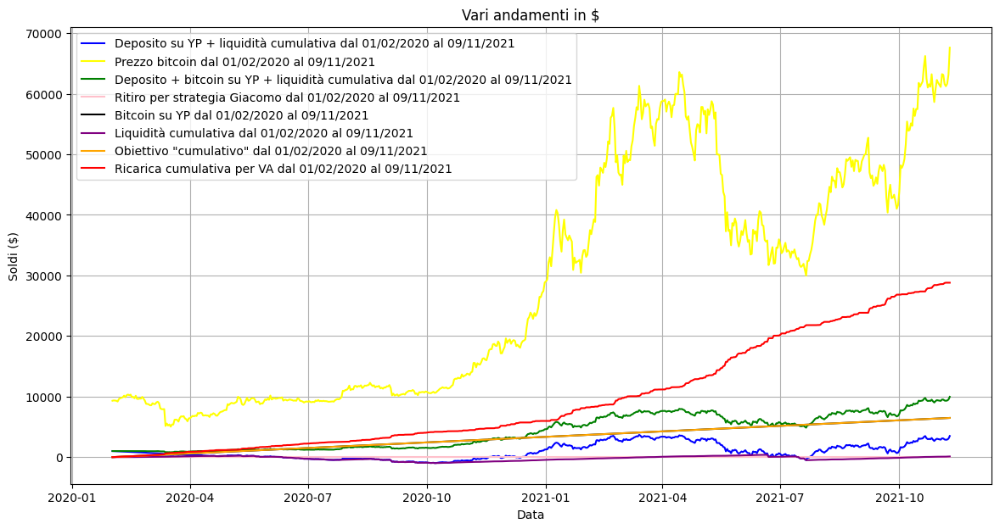

In [319]:
x = dati['Timestamp']
y = tabella_finale['Deposito su YP + liquidità cumulativa in $']
z = tabella_finale['Prezzo bitcoin in $']
w = tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $']
h = tabella_finale['Ritiro per strategia Giacomo in $']
j = tabella_finale['Bitcoin su YP in $']
k = tabella_finale['Liquidità cumulativa']
l = tabella_finale['Obiettivo']
n = tabella_finale['Ricarica cumulativa per VA']
plt.figure(figsize=(14, 7))
plt.plot(x, y, label=f"Deposito su YP + liquidità cumulativa dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='blue')
plt.plot(x, z, label=f"Prezzo bitcoin dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='yellow')
plt.plot(x, w, label=f"Deposito + bitcoin su YP + liquidità cumulativa dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='green')
plt.plot(x, h, label=f"Ritiro per strategia Giacomo dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='pink')
plt.plot(x, j, label=f"Bitcoin su YP dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='black')
plt.plot(x, k, label=f"Liquidità cumulativa dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='purple')
plt.plot(x, l, label=f"Obiettivo \"cumulativo\" dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='orange')
plt.plot(x, n, label=f"Ricarica cumulativa per VA dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='red')
plt.title('Vari andamenti in $')
plt.xlabel('Data')
plt.ylabel('Soldi ($)')
plt.legend()
plt.grid(True)
plt.show()

<h6> Grafico della quantità di Bitcoin (numericamente) </h6>

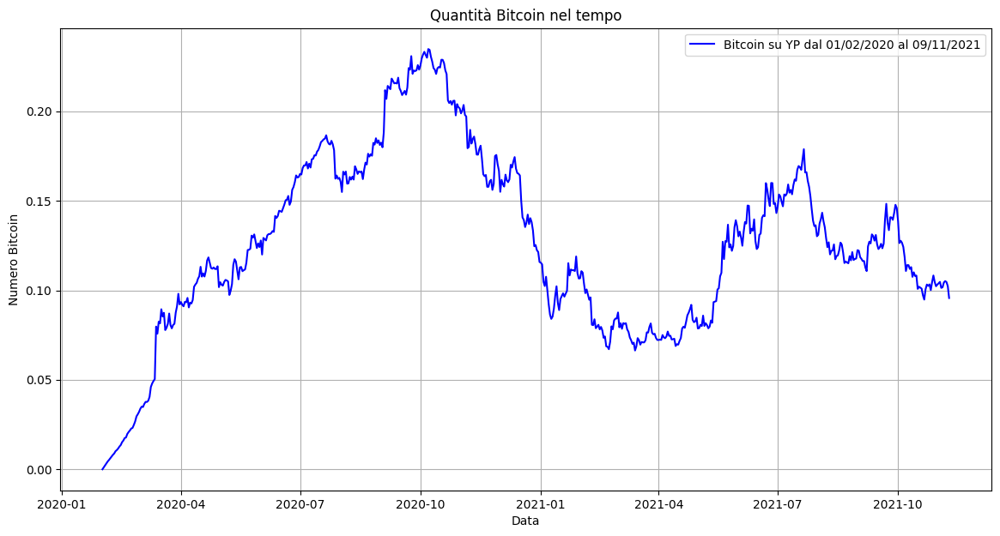

In [320]:
x = dati['Timestamp']
y = tabella_finale['Bitcoin su YP']
plt.figure(figsize=(14, 7))
plt.plot(x, y, label=f"Bitcoin su YP dal {str(x.iloc[0].strftime('%d/%m/%Y'))} al {str(x.iloc[-1].strftime('%d/%m/%Y'))}", color='blue')
plt.title('Quantità Bitcoin nel tempo')
plt.xlabel('Data')
plt.ylabel('Numero Bitcoin')
plt.legend()
plt.grid(True)
plt.show()

### Random search con date casuali

<h6> Function per generare un periodo casuale </h6>

In [321]:
def periodo_casuale(data_iniziale: str, data_finale: str, lunghezza_minima: int):
    formato_data = "%Y-%m-%d"  # ad esempio "2024-02-23"
    
    # Converte le date in oggetti datetime
    data_iniziale = datetime.strptime(data_iniziale, formato_data)
    data_finale = datetime.strptime(data_finale, formato_data)
    
    # Calcola il numero di giorni tra le due date
    giorni_totali = (data_finale - data_iniziale).days
    
    if giorni_totali < lunghezza_minima:
        raise ValueError("La lunghezza minima del periodo è maggiore del numero totale di giorni disponibili.")
    
    # Sceglie un giorno casuale per l'inizio del periodo
    inizio_periodo = data_iniziale + timedelta(days=random.randint(0, giorni_totali - lunghezza_minima))
    
    # Sceglie un giorno casuale per la fine del periodo, che deve essere almeno lunghezza_minima giorni dopo l'inizio
    fine_periodo = inizio_periodo + timedelta(days=random.randint(lunghezza_minima, giorni_totali - (inizio_periodo - data_iniziale).days))
    
    # Converte le date del periodo in stringhe
    inizio_periodo = inizio_periodo.strftime(formato_data)
    fine_periodo = fine_periodo.strftime(formato_data)
    
    return inizio_periodo, fine_periodo

In [322]:
dati = pd.read_csv('bitcoin_data.csv')
dati['Timestamp'] = pd.to_datetime(dati['Timestamp'])

In [323]:
dati.rename(columns={'Timestamp': 'Data'}, inplace=True)
dati.rename(columns={'Price': 'Prezzo bitcoin in $'}, inplace=True)
dati['Deposito su YP + liquidità cumulativa in $'] = 0
dati['Deposito + bitcoin su YP + liquidità cumulativa in $'] = 0

In [324]:
data_iniziale_periodo_casuale = '2021-01-09'
data_finale_periodo_casuale = '2023-12-03' # dati['Timestamp'].iloc[-1].strftime('%Y-%m-%d')
lunghezza_minima_periodo_casuale = 7

In [325]:
data_inizio, data_fine = periodo_casuale(data_iniziale_periodo_casuale, data_finale_periodo_casuale, lunghezza_minima_periodo_casuale)
data_inizio, data_fine

('2022-02-18', '2022-05-05')

In [326]:
data1 = datetime.strptime(data_inizio, '%Y-%m-%d')
data2 = datetime.strptime(data_fine, '%Y-%m-%d')
lunghezza_periodo = (data2-data1).days
lunghezza_periodo

76

In [327]:
indice_inizio = dati[dati['Data'] == data_inizio].index[0]

In [328]:
indice_fine = dati[dati['Data'] == data_fine].index[0]

In [329]:
dati_temp = dati[indice_inizio:indice_fine + 1]

In [330]:
dati_temp = dati_temp.reset_index(drop=True)

In [331]:
colonne = ['Data inizio', 'Data fine', 'Lunghezza periodo (giorni)', 'Soldi in banca iniziali ($)', 'Deposito iniziale ($)', 'Investimento base', 'Strategia Giacomo', 'Percentuale ritiro eccesso', 'Tempo controllo', 'Strategia VA', 'Vendita VA', 'Prima VA', 'Tempo acquisto VA', 'Quantità VA', 'Liquidità cumulativa finale', 'Ricarica cumulativa finale', 'Deposito finale ($)', 'Deposito + liquidità cumulativa finali ($)', 'Bitcoin finali', 'Bitcoin finali ($)', 'Deposito + bitcoin + liquidità cumulativa finali ($)', 'Max delta neg su deposito + liquidità ($)', 'Max delta pos su deposito + liquidità ($)', 'Tasse pagate', 'Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', 'Guadagno / max_delta_neg', 'Guadagno - max_delta_neg']
# Creo un DataFrame vuoto con le colonne specificate
# risultati = pd.DataFrame(columns=colonne)

In [332]:
# Per ogni combinazione di variabili, genero numero_periodi periodi a caso
combinazioni_variabili = 1000
numero_periodi = 100

In [333]:
def bitcoin_in_dollari(bitcoin, prezzo_bitcoin):
                return bitcoin * prezzo_bitcoin

def dollari_in_bitcoin(dollari, prezzo_bitcoin):
                return dollari / prezzo_bitcoin

<h6> Cuore della random search (con più periodi casuali) </h6>

In [334]:
# # tabella_finale = dati.copy()
# # tabella_finale.rename(columns={'Timestamp': 'Data'}, inplace=True)
# # tabella_finale.rename(columns={'Price': 'Prezzo bitcoin in $'}, inplace=True)
# # tabella_finale['Deposito su YP + liquidità cumulativa in $'] = 0
# # tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'] = 0

# modalità = 'random'
# lista_risultati_con_date = []


# for conta in range(combinazioni_variabili):

#         dollari_in_banca = 100000
#         deposito_YP = 0
#         deposito_iniziale = 1000
#         bitcoin_YP = 0
#         bitcoin_YP_in_dollari = 0
#         perc_tassa_acquisto = 0.002
#         liquidità_cumulativa = 0
#         ricarica_cumulativa = 0
#         tasse_pagate = 0

#         # Variabili
#         investimento_base = random.randint(deposito_iniziale-9, deposito_iniziale) # Quanti $ di bitcoin compro il primo giorno; è anche la soglia per sapere se ritirare l'eccesso dei soldi
#         strategia_giacomo = random.choice([True, False])
#         strategia_VA = random.choice([True, True])

#         while not strategia_giacomo and not strategia_VA:
#                 strategia_giacomo = random.choice([True, False])
#                 strategia_VA = random.choice([True, False])

#         if strategia_giacomo:
#                 perc_ritiro = round(random.random(), 2)
#                 tempo_controllo = random.randint(1, lunghezza_periodo) # Ogni quanti giorni controllo se c'è da ritirare l'eccesso dei soldi rispetto all'investimento_base

#         else:
#                 perc_ritiro = '-'
#                 tempo_controllo = '-'
        
#         if strategia_VA:
#                 tempo_acquisto_VA = random.randint(1, 10) # Ogni quanti giorni faccio in modo di comprare (o eventualmente vendere se vendita_VA = True) bitcoin in modo che il totale valga quanto stabilito dall'obiettivo di quel giorno (ad esempio potrei avere come obiettivo il secondo giorno 200$, il terzo giorno 300$ e così via)
#                 quantità_VA = random.randint(deposito_iniziale-9, deposito_iniziale) # ogni tempo_acquisto_VA giorni compro bitcoin in $ pari al valore che serve per avere quantità_VA $ in più rispetto alla volta precedente (in particolare tempo_acquisto_VA giorni prima); quindi inizialmente ho bitcion con valore quantità_VA $, poi tempo_acquisto_VA giorni dopo ne avrò in modo che valgano 2*quantità_VA $, poi tempo_acquisto_VA dopo avrò 3*quantità_VA $ e così via
#                 vendita_VA = random.choice([True, False]) # se è True, significa che è possibile anche che si venda nel caso in cui il valore obiettivo del portafoglio di quel giorno debba essere inferiore a quello che in realtà ho già; se invece è False, in un caso del genere non si fa niente
#         else:
#                 tempo_acquisto_VA = '-'
#                 quantità_VA = '-'
#                 vendita_VA = '-'
#                 # ricarica_cumulativa = '-'
#                 # liquidità_cumulativa = '-'

#         if strategia_VA and strategia_giacomo:
#                 fare_prima_VA = random.choice([True, False]) # se è True, viene fatto prima (eventualmente) il value averaging e poi si ritira (eventualmente) la differenza tra i dollari posseduti su YP e l'investimento iniziale, altrimenti viceversa
#         else:
#                 fare_prima_VA = '-'




#         for indice_periodo in range(numero_periodi):

#                 # Devo reinizializzare queste variabili
#                 dollari_in_banca = 100000
#                 deposito_YP = 0
#                 deposito_iniziale = 1000
#                 bitcoin_YP = 0
#                 bitcoin_YP_in_dollari = 0
#                 perc_tassa_acquisto = 0.002
#                 liquidità_cumulativa = 0
#                 ricarica_cumulativa = 0
#                 tasse_pagate = 0


#                 data_inizio, data_fine = periodo_casuale(data_iniziale_periodo_casuale, data_finale_periodo_casuale, lunghezza_minima_periodo_casuale)

#                 print(f'Mi sto occupando della combinazione {conta+1}/{combinazioni_variabili} del periodo {indice_periodo+1}/{numero_periodi} (che va dal {data_inizio} al {data_fine})...')

#                 data1 = datetime.strptime(data_inizio, '%Y-%m-%d')
#                 data2 = datetime.strptime(data_fine, '%Y-%m-%d')
#                 lunghezza_periodo = (data2-data1).days

#                 indice_inizio = dati[dati['Data'] == data_inizio].index[0]
#                 indice_fine = dati[dati['Data'] == data_fine].index[0]
#                 dati_temp = dati[indice_inizio:indice_fine + 1]
#                 dati_temp = dati_temp.reset_index(drop=True)



#                 prezzo_attuale = dati_temp['Prezzo bitcoin in $'][0]





#                 # Ricarica iniziale del deposito di YP
#                 dollari_in_banca -= deposito_iniziale
#                 deposito_YP += deposito_iniziale

#                 # Acquisto bitcoin su YP per la prima volta, prima di cominciare il ciclo con le mie strategie
#                 deposito_YP -= investimento_base * (1 + perc_tassa_acquisto)
#                 bitcoin_YP += dollari_in_bitcoin(investimento_base, prezzo_attuale)
#                 # print('Prezzo attuale:', prezzo_attuale)
#                 # print('bitcoin_YP', bitcoin_YP)
#                 bitcoin_YP_in_dollari += investimento_base
#                 tasse_pagate += perc_tassa_acquisto * investimento_base

#                 dati_temp['Deposito su YP + liquidità cumulativa in $'][0] = deposito_YP + liquidità_cumulativa
#                 dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][0] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa




#                 # Inizio del calcolo vero e proprio
#                 for t in range(1, len(dati_temp)):
#                         # print(tasse_pagate)
#                         prezzo_attuale = dati_temp['Prezzo bitcoin in $'][t]
#                         # print('Prezzo attuale:', prezzo_attuale)
#                         bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
#                         # print(bitcoin_YP_in_dollari)


#                         if fare_prima_VA != '-' and fare_prima_VA:
#                                 if tempo_acquisto_VA != '-' and t % tempo_acquisto_VA == 0 and strategia_VA != '-' and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
#                                         obiettivo = quantità_VA * t // tempo_acquisto_VA
#                                         ricarica = obiettivo - bitcoin_YP_in_dollari
#                                         liquidità = quantità_VA - ricarica
#                                         if liquidità >= 0 and liquidità <= quantità_VA:
#                                                 if deposito_YP >= liquidità: # correzzione aggiunta tardi
#                                                         deposito_YP -= liquidità
#                                                         # liquidità_ist = liquidità
#                                                         liquidità_cumulativa += liquidità
#                                         elif liquidità > quantità_VA:
#                                                 if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
#                                                         deposito_YP -= quantità_VA
#                                                         # liquidità_ist = quantità_VA
#                                                         liquidità_cumulativa += quantità_VA
#                                         # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
#                                         # else:
#                                         #         # liquidità_ist = 0
#                                         #         liquidità_cumulativa += 0


#                                         if ricarica >= 0:
#                                                 # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
#                                                 if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
#                                                         deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
#                                                         tasse_pagate += perc_tassa_acquisto * ricarica
#                                                 else:
#                                                         liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
#                                                         deposito_YP = 0
#                                                         tasse_pagate += perc_tassa_acquisto * ricarica
#                                                 bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
#                                                 ricarica_cumulativa += ricarica
#                                         elif vendita_VA:
#                                                 deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
#                                                 tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
#                                                 bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

#                                         # tabella_finale['Obiettivo'][t] = obiettivo


#                                 if tempo_controllo!='-' and t % tempo_controllo == 0 and strategia_giacomo!='-' and strategia_giacomo:
#                                         if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
#                                                 ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
#                                                 deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
#                                                 tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
#                                                 bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

#                         else:

#                                 if tempo_controllo!='-' and t % tempo_controllo == 0 and strategia_giacomo!='-' and strategia_giacomo:
#                                         if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
#                                                 ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
#                                                 deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
#                                                 tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
#                                                 bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)


#                                 if tempo_acquisto_VA != '-' and t % tempo_acquisto_VA == 0 and strategia_VA != '-' and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
#                                         obiettivo = quantità_VA * t // tempo_acquisto_VA
#                                         # print('Obiettivo:', obiettivo)
#                                         ricarica = obiettivo - bitcoin_YP_in_dollari
#                                         # print('Ricarica:', ricarica)
#                                         # print('Bitcoin YP', bitcoin_YP)
#                                         # print('Bitcoin YP in $', bitcoin_YP_in_dollari)
#                                         liquidità = quantità_VA - ricarica
#                                         if liquidità >= 0 and liquidità <= quantità_VA:
#                                                 if deposito_YP >= liquidità: # correzzione aggiunta tardi
#                                                         deposito_YP -= liquidità
#                                                         # liquidità_ist = liquidità
#                                                         liquidità_cumulativa += liquidità
#                                         elif liquidità > quantità_VA:
#                                                 if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
#                                                         deposito_YP -= quantità_VA
#                                                         # liquidità_ist = quantità_VA
#                                                         liquidità_cumulativa += quantità_VA
#                                         # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
#                                         # else:
#                                         #         # liquidità_ist = 0
#                                         #         liquidità_cumulativa += 0
                                                

#                                         if ricarica >= 0:
#                                                 # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
#                                                 if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
#                                                         deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
#                                                         tasse_pagate += perc_tassa_acquisto * ricarica
#                                                 else:
#                                                         liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
#                                                         deposito_YP = 0
#                                                         tasse_pagate += perc_tassa_acquisto * ricarica
#                                                 bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
#                                                 ricarica_cumulativa += ricarica
#                                         elif vendita_VA:
#                                                 deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
#                                                 tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
#                                                 bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
#                                                 bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)


#                         dati_temp['Deposito su YP + liquidità cumulativa in $'][t] = deposito_YP + liquidità_cumulativa
#                         dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][t] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa



#                 # Analisi post calcolo
#                 max_delta_neg = 0
#                 max_delta_pos = 0
#                 guadagno_finale = 0



#                 # ind_neg = 'Nessuno'
#                 # ind_pos = 'Nessuno'

#                 for index, i in enumerate(dati_temp['Deposito su YP + liquidità cumulativa in $']):
#                         if deposito_iniziale - i > max_delta_neg:
#                                 max_delta_neg = deposito_iniziale - i

#                         if i - deposito_iniziale > max_delta_pos:
#                                 max_delta_pos = i - deposito_iniziale



#                 guadagno_finale = dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][len(dati_temp) - 1] - dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][0]


#                 # Popolo la tabella dei risultati
#                 nuovi_dati = [data_inizio, data_fine, lunghezza_periodo, dollari_in_banca, deposito_iniziale, investimento_base, strategia_giacomo, perc_ritiro, tempo_controllo, strategia_VA, vendita_VA, fare_prima_VA, tempo_acquisto_VA, quantità_VA, liquidità_cumulativa, ricarica_cumulativa, deposito_YP, deposito_YP + liquidità_cumulativa, bitcoin_YP, bitcoin_YP_in_dollari, deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa, max_delta_neg, max_delta_pos, tasse_pagate, guadagno_finale, guadagno_finale / max_delta_neg, guadagno_finale - max_delta_neg]

#                 # risultati = risultati.append(pd.Series(nuovi_dati, index=colonne), ignore_index=True)

#                 # In futuro dovrei essere costretto a usare il codice qui sotto al posto di append, ma provando ho notato che è molto più lento
#                 # nuova_serie = pd.Series(nuovi_dati, index=colonne)
#                 # risultati = pd.concat([risultati, nuova_serie], ignore_index=True)

#                 # aggiungi i tuoi dati alla lista come dizionari
#                 lista_risultati_con_date.append(dict(zip(colonne, nuovi_dati)))
#                 # alla fine, crea un DataFrame
        
# risultati_con_date = pd.DataFrame(lista_risultati_con_date)

### Grid search

In [335]:
# tabella_finale = dati.copy()
# tabella_finale.rename(columns={'Timestamp': 'Data'}, inplace=True)
# tabella_finale.rename(columns={'Price': 'Prezzo bitcoin in $'}, inplace=True)
# tabella_finale['Deposito su YP + liquidità cumulativa in $'] = 0
# tabella_finale['Deposito + bitcoin su YP + liquidità cumulativa in $'] = 0

modalità = 'grid'
già_fatte = []
cont = 0

lista_risultati_con_date = []

param_grid = {
    'investimento_base': list(np.arange(0, 41, 20)), # Quanti $ di bitcoin compro il primo giorno; è anche la soglia per sapere se ritirare l'eccesso dei soldi
    'strategia_giacomo': [True, False],
    'perc_ritiro': list(np.arange(0.95, 1.01, 0.01)),
    'tempo_controllo': list(np.arange(1, 302, 100)),
    'strategia_VA': [True],
    'fare_prima_VA': [True, False],
    'tempo_acquisto_VA': [110, 200, 500], # list(np.arange(1, 2, 1)), # Ogni quanti giorni faccio in modo di comprare (o eventualmente vendere se vendita_VA = True) bitcoin in modo che il totale valga quanto stabilito dall'obiettivo di quel giorno (ad esempio potrei avere come obiettivo il secondo giorno 200$, il terzo giorno 300$ e così via)
    'quantità_VA': [1, 10], # list(np.arange(10, 11, 50)), # Ogni tempo_acquisto_VA giorni compro bitcoin in $ pari al valore che serve per avere quantità_VA $ in più rispetto alla volta precedente (in particolare tempo_acquisto_VA giorni prima); quindi inizialmente ho bitcion con valore quantità_VA $, poi tempo_acquisto_VA giorni dopo ne avrò in modo che valgano 2*quantità_VA $, poi tempo_acquisto_VA dopo avrò 3*quantità_VA $ e così via
    'vendita_VA': [True, False] # Se è True, significa che è possibile anche che si venda nel caso in cui il valore obiettivo del portafoglio di quel giorno debba essere inferiore a quello che in realtà ho già; se invece è False, in un caso del genere non si fa niente
}

combinazioni_variabili = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

for conta, params in enumerate(combinazioni_variabili):

        investimento_base, strategia_giacomo, perc_ritiro_eventuale, tempo_controllo_eventuale, strategia_VA, fare_prima_VA_eventuale, tempo_acquisto_VA, quantità_VA, vendita_VA = params.values()

        dollari_in_banca = 100000
        deposito_YP = 0
        deposito_iniziale = 1000
        bitcoin_YP = 0
        bitcoin_YP_in_dollari = 0
        perc_tassa_acquisto = 0.002
        liquidità_cumulativa = 0
        ricarica_cumulativa = 0
        tasse_pagate = 0

        # Variabili
        if strategia_giacomo:
                perc_ritiro = perc_ritiro_eventuale
                tempo_controllo = tempo_controllo_eventuale # Ogni quanti giorni controllo se c'è da ritirare l'eccesso dei soldi rispetto all'investimento_base

        else:
                perc_ritiro = '-'
                tempo_controllo = '-'
        

        if strategia_VA and strategia_giacomo:
                fare_prima_VA = fare_prima_VA_eventuale # se è True, viene fatto prima (eventualmente) il value averaging e poi si ritira (eventualmente) la differenza tra i dollari posseduti su YP e l'investimento iniziale, altrimenti viceversa
        else:
                fare_prima_VA = '-'


        # Controllo di non aver già fatto una certa combinazione, altrimenti salto al ciclo successivo
        if [investimento_base, strategia_giacomo, perc_ritiro, tempo_controllo, strategia_VA, fare_prima_VA, tempo_acquisto_VA, quantità_VA, vendita_VA] in già_fatte:
                cont += 1
                print(f'Questa l\'ho già fatta e la salto, è la numero {cont}!')
                continue
        else:
                già_fatte.append([investimento_base, strategia_giacomo, perc_ritiro, tempo_controllo, strategia_VA, fare_prima_VA, tempo_acquisto_VA, quantità_VA, vendita_VA])




        for indice_periodo in range(numero_periodi):

                # Devo reinizializzare queste variabili
                dollari_in_banca = 100000
                deposito_YP = 0
                deposito_iniziale = 1000
                bitcoin_YP = 0
                bitcoin_YP_in_dollari = 0
                perc_tassa_acquisto = 0.002
                liquidità_cumulativa = 0
                ricarica_cumulativa = 0
                tasse_pagate = 0


                data_inizio, data_fine = periodo_casuale(data_iniziale_periodo_casuale, data_finale_periodo_casuale, lunghezza_minima_periodo_casuale)

                print(f'Mi sto occupando della combinazione {conta+1}/{len(combinazioni_variabili)} del periodo {indice_periodo+1}/{numero_periodi} (che va dal {data_inizio} al {data_fine})...')

                data1 = datetime.strptime(data_inizio, '%Y-%m-%d')
                data2 = datetime.strptime(data_fine, '%Y-%m-%d')
                lunghezza_periodo = (data2-data1).days

                indice_inizio = dati[dati['Data'] == data_inizio].index[0]
                indice_fine = dati[dati['Data'] == data_fine].index[0]
                dati_temp = dati[indice_inizio:indice_fine + 1]
                dati_temp = dati_temp.reset_index(drop=True)



                prezzo_attuale = dati_temp['Prezzo bitcoin in $'][0]





                # Ricarica iniziale del deposito di YP
                dollari_in_banca -= deposito_iniziale
                deposito_YP += deposito_iniziale

                # Acquisto bitcoin su YP per la prima volta, prima di cominciare il ciclo con le mie strategie
                deposito_YP -= investimento_base * (1 + perc_tassa_acquisto)
                bitcoin_YP += dollari_in_bitcoin(investimento_base, prezzo_attuale)
                # print('Prezzo attuale:', prezzo_attuale)
                # print('bitcoin_YP', bitcoin_YP)
                bitcoin_YP_in_dollari += investimento_base
                tasse_pagate += perc_tassa_acquisto * investimento_base

                dati_temp['Deposito su YP + liquidità cumulativa in $'][0] = deposito_YP + liquidità_cumulativa
                dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][0] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa




                # Inizio del calcolo vero e proprio
                for t in range(1, len(dati_temp)):
                        # print(tasse_pagate)
                        prezzo_attuale = dati_temp['Prezzo bitcoin in $'][t]
                        # print('Prezzo attuale:', prezzo_attuale)
                        bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                        # print(bitcoin_YP_in_dollari)


                        if fare_prima_VA != '-' and fare_prima_VA:
                                if tempo_acquisto_VA != '-' and t % tempo_acquisto_VA == 0 and strategia_VA != '-' and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
                                        obiettivo = quantità_VA * t // tempo_acquisto_VA
                                        ricarica = obiettivo - bitcoin_YP_in_dollari
                                        liquidità = quantità_VA - ricarica
                                        if liquidità >= 0 and liquidità <= quantità_VA:
                                                if deposito_YP >= liquidità: # correzzione aggiunta tardi
                                                        deposito_YP -= liquidità
                                                        # liquidità_ist = liquidità
                                                        liquidità_cumulativa += liquidità
                                        elif liquidità > quantità_VA:
                                                if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
                                                        deposito_YP -= quantità_VA
                                                        # liquidità_ist = quantità_VA
                                                        liquidità_cumulativa += quantità_VA
                                        # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
                                        # else:
                                        #         # liquidità_ist = 0
                                        #         liquidità_cumulativa += 0


                                        if ricarica >= 0:
                                                # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
                                                if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
                                                        deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
                                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                                else:
                                                        liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
                                                        deposito_YP = 0
                                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                                                ricarica_cumulativa += ricarica
                                        elif vendita_VA:
                                                deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
                                                tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
                                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

                                        # tabella_finale['Obiettivo'][t] = obiettivo


                                if tempo_controllo!='-' and t % tempo_controllo == 0 and strategia_giacomo!='-' and strategia_giacomo:
                                        if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
                                                ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
                                                deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
                                                tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
                                                bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)

                        else:

                                if tempo_controllo!='-' and t % tempo_controllo == 0 and strategia_giacomo!='-' and strategia_giacomo:
                                        if bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) > investimento_base:
                                                ritiro_in_dollari = (bitcoin_in_dollari(bitcoin_YP, prezzo_attuale) - investimento_base) * perc_ritiro
                                                deposito_YP += ritiro_in_dollari * (1 - perc_tassa_acquisto)
                                                tasse_pagate += perc_tassa_acquisto * ritiro_in_dollari
                                                bitcoin_YP -= dollari_in_bitcoin(ritiro_in_dollari, prezzo_attuale)
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)


                                if tempo_acquisto_VA != '-' and t % tempo_acquisto_VA == 0 and strategia_VA != '-' and strategia_VA: # Se è un giorno in cui voglio comprare altri bitcoin
                                        obiettivo = quantità_VA * t // tempo_acquisto_VA
                                        # print('Obiettivo:', obiettivo)
                                        ricarica = obiettivo - bitcoin_YP_in_dollari
                                        # print('Ricarica:', ricarica)
                                        # print('Bitcoin YP', bitcoin_YP)
                                        # print('Bitcoin YP in $', bitcoin_YP_in_dollari)
                                        liquidità = quantità_VA - ricarica
                                        if liquidità >= 0 and liquidità <= quantità_VA:
                                                if deposito_YP >= liquidità: # correzzione aggiunta tardi
                                                        deposito_YP -= liquidità
                                                        # liquidità_ist = liquidità
                                                        liquidità_cumulativa += liquidità
                                        elif liquidità > quantità_VA:
                                                if deposito_YP >= quantità_VA: # correzzione aggiunta tardi
                                                        deposito_YP -= quantità_VA
                                                        # liquidità_ist = quantità_VA
                                                        liquidità_cumulativa += quantità_VA
                                        # Questo else è superfluo perchè il fondo liquidità è già 0 di base, inoltre aggiungere 0 è come non fare nulla, ma lo lascio per chiarezza
                                        # else:
                                        #         # liquidità_ist = 0
                                        #         liquidità_cumulativa += 0
                                                

                                        if ricarica >= 0:
                                                # Se non ci sono abbastanza soldi nel deposito, prendo tutto dal deposito e quello che manca dalla liquidità accumulata
                                                if ricarica * (1 + perc_tassa_acquisto) <= deposito_YP:
                                                        deposito_YP -= ricarica * (1 + perc_tassa_acquisto)
                                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                                else:
                                                        liquidità_cumulativa -= ricarica * (1 + perc_tassa_acquisto) - deposito_YP
                                                        deposito_YP = 0
                                                        tasse_pagate += perc_tassa_acquisto * ricarica
                                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale)
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)
                                                ricarica_cumulativa += ricarica
                                        elif vendita_VA:
                                                deposito_YP -= ricarica * (1 - perc_tassa_acquisto) # aumenta il deposito perchè qui ricarica è negativa; poi ci sono le tasse anche sulla vendita
                                                tasse_pagate -= perc_tassa_acquisto * ricarica # anche qui è importante ricordare il "-" perchè ricarica è negativa
                                                bitcoin_YP += dollari_in_bitcoin(ricarica, prezzo_attuale) # calano perchè qui ricarica è negativa
                                                bitcoin_YP_in_dollari = bitcoin_in_dollari(bitcoin_YP, prezzo_attuale)


                        dati_temp['Deposito su YP + liquidità cumulativa in $'][t] = deposito_YP + liquidità_cumulativa
                        dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][t] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa



                # Analisi post calcolo
                max_delta_neg = 0
                max_delta_pos = 0
                guadagno_finale = 0



                # ind_neg = 'Nessuno'
                # ind_pos = 'Nessuno'

                for index, i in enumerate(dati_temp['Deposito su YP + liquidità cumulativa in $']):
                        if deposito_iniziale - i > max_delta_neg:
                                max_delta_neg = deposito_iniziale - i

                        if i - deposito_iniziale > max_delta_pos:
                                max_delta_pos = i - deposito_iniziale



                guadagno_finale = dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][len(dati_temp) - 1] - dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][0]


                # Popolo la tabella dei risultati
                nuovi_dati = [data_inizio, data_fine, lunghezza_periodo, dollari_in_banca, deposito_iniziale, investimento_base, strategia_giacomo, perc_ritiro, tempo_controllo, strategia_VA, vendita_VA, fare_prima_VA, tempo_acquisto_VA, quantità_VA, liquidità_cumulativa, ricarica_cumulativa, deposito_YP, deposito_YP + liquidità_cumulativa, bitcoin_YP, bitcoin_YP_in_dollari, deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa, max_delta_neg, max_delta_pos, tasse_pagate, guadagno_finale, guadagno_finale / max_delta_neg, guadagno_finale - max_delta_neg]

                # risultati = risultati.append(pd.Series(nuovi_dati, index=colonne), ignore_index=True)

                # In futuro dovrei essere costretto a usare il codice qui sotto al posto di append, ma provando ho notato che è molto più lento
                # nuova_serie = pd.Series(nuovi_dati, index=colonne)
                # risultati = pd.concat([risultati, nuova_serie], ignore_index=True)

                # aggiungi i tuoi dati alla lista come dizionari
                lista_risultati_con_date.append(dict(zip(colonne, nuovi_dati)))
                # alla fine, crea un DataFrame
        
risultati_con_date = pd.DataFrame(lista_risultati_con_date)

Mi sto occupando della combinazione 1/4032 del periodo 1/100 (che va dal 2022-09-18 al 2022-10-29)...
Mi sto occupando della combinazione 1/4032 del periodo 2/100 (che va dal 2023-11-13 al 2023-12-03)...
Mi sto occupando della combinazione 1/4032 del periodo 3/100 (che va dal 2021-07-27 al 2022-09-14)...


C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\3471652386.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dati_temp['Deposito su YP + liquidità cumulativa in $'][0] = deposito_YP + liquidità_cumulativa
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\3471652386.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dati_temp['Deposito + bitcoin su YP + liquidità cumulativa in $'][0] = deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\3471652386.py:234: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Mi sto occupando della combinazione 1/4032 del periodo 4/100 (che va dal 2021-10-29 al 2022-04-24)...
Mi sto occupando della combinazione 1/4032 del periodo 5/100 (che va dal 2022-08-25 al 2023-05-27)...
Mi sto occupando della combinazione 1/4032 del periodo 6/100 (che va dal 2022-10-07 al 2023-02-25)...
Mi sto occupando della combinazione 1/4032 del periodo 7/100 (che va dal 2022-01-30 al 2022-07-20)...
Mi sto occupando della combinazione 1/4032 del periodo 8/100 (che va dal 2023-08-08 al 2023-10-30)...
Mi sto occupando della combinazione 1/4032 del periodo 9/100 (che va dal 2022-06-30 al 2023-09-05)...
Mi sto occupando della combinazione 1/4032 del periodo 10/100 (che va dal 2022-12-16 al 2023-04-11)...
Mi sto occupando della combinazione 1/4032 del periodo 11/100 (che va dal 2022-03-03 al 2022-05-31)...
Mi sto occupando della combinazione 1/4032 del periodo 12/100 (che va dal 2022-01-18 al 2022-12-30)...
Mi sto occupando della combinazione 1/4032 del periodo 13/100 (che va dal 2021-

Mi sto occupando della combinazione 1/4032 del periodo 37/100 (che va dal 2021-04-29 al 2022-06-26)...
Mi sto occupando della combinazione 1/4032 del periodo 38/100 (che va dal 2023-08-20 al 2023-11-26)...
Mi sto occupando della combinazione 1/4032 del periodo 39/100 (che va dal 2023-10-03 al 2023-10-25)...
Mi sto occupando della combinazione 1/4032 del periodo 40/100 (che va dal 2022-10-15 al 2023-05-03)...
Mi sto occupando della combinazione 1/4032 del periodo 41/100 (che va dal 2023-10-11 al 2023-12-03)...
Mi sto occupando della combinazione 1/4032 del periodo 42/100 (che va dal 2023-07-23 al 2023-08-20)...
Mi sto occupando della combinazione 1/4032 del periodo 43/100 (che va dal 2021-01-11 al 2022-10-14)...
Mi sto occupando della combinazione 1/4032 del periodo 44/100 (che va dal 2021-11-29 al 2023-10-02)...
Mi sto occupando della combinazione 1/4032 del periodo 45/100 (che va dal 2021-08-13 al 2023-07-30)...
Mi sto occupando della combinazione 1/4032 del periodo 46/100 (che va dal

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\3471652386.py:262: RuntimeWarning: divide by zero encountered in scalar divide
  nuovi_dati = [data_inizio, data_fine, lunghezza_periodo, dollari_in_banca, deposito_iniziale, investimento_base, strategia_giacomo, perc_ritiro, tempo_controllo, strategia_VA, vendita_VA, fare_prima_VA, tempo_acquisto_VA, quantità_VA, liquidità_cumulativa, ricarica_cumulativa, deposito_YP, deposito_YP + liquidità_cumulativa, bitcoin_YP, bitcoin_YP_in_dollari, deposito_YP + bitcoin_YP_in_dollari + liquidità_cumulativa, max_delta_neg, max_delta_pos, tasse_pagate, guadagno_finale, guadagno_finale / max_delta_neg, guadagno_finale - max_delta_neg]


Mi sto occupando della combinazione 577/4032 del periodo 3/100 (che va dal 2021-12-24 al 2023-06-26)...
Mi sto occupando della combinazione 577/4032 del periodo 4/100 (che va dal 2021-10-23 al 2023-03-26)...
Mi sto occupando della combinazione 577/4032 del periodo 5/100 (che va dal 2021-09-30 al 2022-12-03)...
Mi sto occupando della combinazione 577/4032 del periodo 6/100 (che va dal 2022-11-16 al 2022-12-02)...
Mi sto occupando della combinazione 577/4032 del periodo 7/100 (che va dal 2023-10-17 al 2023-11-12)...
Mi sto occupando della combinazione 577/4032 del periodo 8/100 (che va dal 2021-12-25 al 2023-06-23)...
Mi sto occupando della combinazione 577/4032 del periodo 9/100 (che va dal 2021-12-12 al 2023-09-13)...
Mi sto occupando della combinazione 577/4032 del periodo 10/100 (che va dal 2022-06-28 al 2023-03-03)...
Mi sto occupando della combinazione 577/4032 del periodo 11/100 (che va dal 2021-11-04 al 2023-06-19)...
Mi sto occupando della combinazione 577/4032 del periodo 12/10

<h6> Aggiungo altre colonne </h6>

In [336]:
risultati_con_date['Guadagno - max_delta_neg - lunghezza periodo'] = risultati_con_date['Guadagno - max_delta_neg'] - risultati_con_date['Lunghezza periodo (giorni)']

In [337]:
risultati_con_date['(Guadagno - max_delta_neg) / lunghezza periodo'] = risultati_con_date['Guadagno - max_delta_neg'] / risultati_con_date['Lunghezza periodo (giorni)']

<h6> Tabelle </h6>

In [338]:
risultati_con_date

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
0,2022-09-18,2022-10-29,41,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,0.0,1000.000000,1000.000000,0.000000e+00,0.000000e+00,1000.000000,0.000000,0.0,0.000000,0.000000,NaN,0.000000,-41.000000,0.000000
1,2023-11-13,2023-12-03,20,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,0.0,1000.000000,1000.000000,0.000000e+00,0.000000e+00,1000.000000,0.000000,0.0,0.000000,0.000000,NaN,0.000000,-20.000000,0.000000
2,2021-07-27,2022-09-14,414,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,6.0,999.964203,999.964203,3.746122e-115,7.561535e-111,999.964203,0.180716,0.0,0.023976,-0.035797,-0.198084,-0.216513,-414.216513,-0.000523
3,2021-10-29,2022-04-24,177,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,1.0,999.995231,999.995231,7.601085e-94,3.007124e-89,999.995231,0.053900,0.0,0.003998,-0.004769,-0.088486,-0.058669,-177.058669,-0.000331
4,2022-08-25,2023-05-27,275,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,3.0,999.988766,999.988766,9.739159e-78,2.602107e-73,999.988766,0.110044,0.0,0.012002,-0.011234,-0.102083,-0.121278,-275.121278,-0.000441
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205195,2022-01-20,2023-04-16,451,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,9.580941e-04,2.904190e+01,988.961904,40.080000,0.0,0.080000,-10.958096,-0.273406,-51.038096,-502.038096,-0.113167
205196,2021-07-26,2023-03-29,611,99000,1000,40,False,-,-,True,False,-,500,10,10.0,0.0,949.920000,959.920000,1.128155e-03,3.078887e+01,990.708870,40.080000,0.0,0.080000,-9.211130,-0.229819,-49.291130,-660.291130,-0.080673
205197,2021-07-06,2022-07-26,385,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,1.178963e-03,2.514762e+01,985.067620,40.080000,0.0,0.080000,-14.852380,-0.370568,-54.932380,-439.932380,-0.142682
205198,2023-04-25,2023-05-11,16,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,1.453930e-03,4.018625e+01,1000.106245,40.080000,0.0,0.080000,0.186245,0.004647,-39.893755,-55.893755,-2.493360


In [339]:
risultati_deduplicati_con_date = risultati_con_date.drop_duplicates()

In [340]:
# Ordino la tabella in base al guadagno finale
ordine1 = risultati_deduplicati_con_date.sort_values(by='Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', ascending=False)
ordine1

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
174300,2021-01-13,2023-11-07,1028,99000,1000,40,True,0.98,301,True,False,False,110,10,46.938377,117.569472,891.642649,938.581026,0.003344,117.130099,1055.711125,61.418974,0.000000,0.508457,55.791125,0.908370,-5.627849,-1033.627849,-0.005475
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002466,95.395774,1055.315774,40.080000,0.000000,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
149078,2021-07-18,2023-11-19,854,99000,1000,40,True,0.96,101,True,True,True,110,10,12.566972,104.332113,985.842993,998.409966,0.001507,55.134957,1053.544923,40.080000,27.209424,0.575299,53.624923,1.337947,13.544923,-840.455077,0.015861
8762,2021-01-29,2023-11-27,1032,99000,1000,0,True,0.95,301,True,False,False,110,10,21.996973,233.411825,906.659490,928.656464,0.003315,124.280977,1052.937441,87.434594,13.953132,0.792545,52.937441,0.605452,-34.497153,-1066.497153,-0.033427
198307,2021-01-22,2023-12-03,1045,99000,1000,40,True,1.01,101,True,False,False,110,10,30.000000,174.632017,976.214352,1006.214352,0.001153,45.514634,1051.728986,65.887552,6.214352,0.872702,51.808986,0.786324,-14.078566,-1059.078566,-0.013472
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174235,2021-02-23,2022-12-29,674,99000,1000,40,True,0.98,301,True,True,False,110,10,12.297186,83.889382,887.812438,900.109624,0.003369,55.721836,955.831460,99.890376,0.000000,0.296370,-44.088540,-0.441369,-143.978917,-817.978917,-0.213619
144204,2021-03-27,2022-11-29,612,99000,1000,40,True,0.95,301,True,True,True,110,10,18.590212,60.387722,898.197109,916.787321,0.002405,39.018811,955.806131,86.719036,0.000000,0.235597,-44.113869,-0.508699,-130.832905,-742.832905,-0.213779
171856,2021-02-20,2022-11-21,639,99000,1000,40,True,0.98,201,True,True,False,110,10,11.713469,59.319398,909.674393,921.387862,0.002102,34.265658,955.653519,82.746154,0.000000,0.240534,-44.266481,-0.534967,-127.012635,-766.012635,-0.198768
158660,2021-03-12,2022-12-22,650,99000,1000,40,True,0.97,101,True,True,True,110,10,17.121350,57.843019,905.613404,922.734754,0.001951,32.807084,955.541838,83.171666,0.000000,0.237316,-44.378162,-0.533573,-127.549828,-777.549828,-0.196231


In [341]:
ordine3 = risultati_deduplicati_con_date.sort_values(by='Guadagno - max_delta_neg', ascending=False)
ordine3

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002466,95.395774,1055.315774,40.080000,0.000000,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
149078,2021-07-18,2023-11-19,854,99000,1000,40,True,0.96,101,True,True,True,110,10,12.566972,104.332113,985.842993,998.409966,0.001507,55.134957,1053.544923,40.080000,27.209424,0.575299,53.624923,1.337947,13.544923,-840.455077,0.015861
159828,2021-07-28,2023-12-03,858,99000,1000,40,True,0.97,101,True,True,False,110,10,18.106567,103.363607,972.892639,990.999206,0.001527,60.287989,1051.287195,40.819775,15.427027,0.556566,51.367195,1.258390,10.547420,-847.452580,0.012293
205119,2022-11-23,2023-11-19,361,99000,1000,40,False,-,-,True,False,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002473,90.485302,1050.405302,40.080000,0.000000,0.080000,50.485302,1.259613,10.405302,-350.594698,0.028824
165107,2023-01-02,2023-12-03,335,99000,1000,40,True,0.97,301,True,False,False,200,10,10.000000,0.000000,991.728602,1001.728602,0.001195,47.181655,1048.910257,40.080000,1.728602,0.163785,48.990257,1.222312,8.910257,-326.089743,0.026598
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164723,2021-02-13,2023-01-02,688,99000,1000,40,True,0.97,301,True,False,False,110,10,33.527321,57.129368,869.810208,903.337530,0.003499,58.131902,961.469432,96.662470,0.000000,0.195584,-38.450568,-0.397782,-135.113038,-823.113038,-0.196385
179161,2021-02-18,2022-12-29,679,99000,1000,40,True,0.99,101,True,False,False,110,10,30.000000,62.501694,871.819140,901.819140,0.003499,57.862655,959.681795,98.180860,0.000000,0.214073,-40.238205,-0.409838,-138.419065,-817.419065,-0.203857
54322,2021-01-12,2022-12-22,709,99000,1000,0,True,1.0,201,True,False,False,110,10,1.669751,170.524611,903.906898,905.576650,0.002976,50.042760,955.619410,94.423350,0.000000,0.494240,-44.380590,-0.470017,-138.803940,-847.803940,-0.195774
187434,2021-03-04,2023-01-03,670,99000,1000,40,True,1.0,101,True,True,True,110,10,17.383190,85.776168,883.226860,900.610050,0.003573,59.581527,960.191577,99.389950,0.000000,0.304935,-39.728423,-0.399723,-139.118372,-809.118372,-0.207639


In [342]:
ordine4 = risultati_deduplicati_con_date.sort_values(by='Guadagno - max_delta_neg - lunghezza periodo', ascending=False)
ordine4

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
31790,2023-11-05,2023-11-12,7,99000,1000,0,True,0.98,101,True,False,True,200,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
58965,2023-11-25,2023-12-02,7,99000,1000,0,True,1.01,1,True,False,False,110,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
42389,2023-11-26,2023-12-03,7,99000,1000,0,True,0.99,101,True,False,False,110,10,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
59253,2023-11-26,2023-12-03,7,99000,1000,0,True,1.01,1,True,True,False,200,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
341,2023-08-08,2023-08-15,7,99000,1000,0,True,0.95,1,True,False,True,110,10,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110774,2021-01-15,2023-11-29,1048,99000,1000,20,True,0.99,101,True,False,False,110,10,20.000000,279.427923,967.629385,987.629385,0.000694,26.232607,1013.861991,90.362520,0.000000,1.175321,13.901991,0.153847,-76.460529,-1124.460529,-0.072959
120254,2021-02-09,2023-12-03,1027,99000,1000,20,True,1.0,101,True,True,False,110,10,13.768329,277.166088,966.426577,980.194906,0.000528,20.832639,1001.027546,99.466501,0.000000,1.151357,1.067546,0.010733,-98.398955,-1125.398955,-0.095812
109536,2021-01-15,2023-12-02,1051,99000,1000,20,True,0.99,101,True,False,True,110,10,20.000000,279.427923,967.629385,987.629385,0.000694,26.847456,1014.476841,90.362520,0.000000,1.175321,14.516841,0.160651,-75.845680,-1126.845680,-0.072165
42318,2021-01-16,2023-11-13,1031,99000,1000,0,True,0.99,101,True,False,False,110,10,0.000000,446.481495,1003.236406,1003.236406,0.000033,1.208070,1004.444476,106.743677,3.246935,1.795991,4.444476,0.041637,-102.299201,-1133.299201,-0.099223


In [343]:
ordine5 = risultati_deduplicati_con_date.sort_values(by='(Guadagno - max_delta_neg) / lunghezza periodo', ascending=False)
ordine5

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
183177,2021-07-21,2021-11-15,117,99000,1000,40,True,0.99,301,True,False,True,200,10,0.0,0.0,959.920000,959.920000,0.001335,87.614024,1047.534024,40.08,0.0,0.080000,47.614024,1.187975,7.534024,-109.465976,0.064393
150170,2021-07-20,2021-10-21,93,99000,1000,40,True,0.96,101,True,False,False,110,1,0.0,0.0,959.920000,959.920000,0.001293,85.666146,1045.586146,40.08,0.0,0.080000,45.666146,1.139375,5.586146,-87.413854,0.060066
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.0,0.0,959.920000,959.920000,0.002466,95.395774,1055.315774,40.08,0.0,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
184797,2021-07-21,2021-10-19,90,99000,1000,40,True,0.99,301,True,False,False,500,10,0.0,0.0,959.920000,959.920000,0.001335,82.768146,1042.688146,40.08,0.0,0.080000,42.768146,1.067070,2.688146,-87.311854,0.029868
205119,2022-11-23,2023-11-19,361,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,0.002473,90.485302,1050.405302,40.08,0.0,0.080000,50.485302,1.259613,10.405302,-350.594698,0.028824
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177006,2022-11-03,2022-11-10,7,99000,1000,40,True,0.99,1,True,True,False,200,10,0.0,0.0,962.118255,962.118255,0.001880,29.588905,991.707160,40.08,0.0,0.084405,-8.212840,-0.204911,-48.292840,-55.292840,-6.898977
189811,2022-11-03,2022-11-10,7,99000,1000,40,True,1.0,201,True,True,True,110,10,0.0,0.0,959.920000,959.920000,0.001984,31.230391,991.150391,40.08,0.0,0.080000,-8.769609,-0.218803,-48.849609,-55.849609,-6.978516
145914,2022-11-03,2022-11-10,7,99000,1000,40,True,0.95,301,True,False,False,200,10,0.0,0.0,959.920000,959.920000,0.001984,31.230391,991.150391,40.08,0.0,0.080000,-8.769609,-0.218803,-48.849609,-55.849609,-6.978516
137416,2021-05-15,2021-05-22,7,99000,1000,40,True,0.95,1,True,True,True,200,10,0.0,0.0,959.920000,959.920000,0.000801,29.923617,989.843617,40.08,0.0,0.080000,-10.076383,-0.251407,-50.156383,-57.156383,-7.165198


In [344]:
soglia = deposito_iniziale
risultati_con_date_con_investimenti_sotto_soglia = risultati_deduplicati_con_date[risultati_deduplicati_con_date['Max delta neg su deposito + liquidità ($)'] <= soglia]
risultati_con_date_con_investimenti_sotto_soglia

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
0,2022-09-18,2022-10-29,41,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,0.0,1000.000000,1000.000000,0.000000e+00,0.000000e+00,1000.000000,0.000000,0.0,0.000000,0.000000,NaN,0.000000,-41.000000,0.000000
1,2023-11-13,2023-12-03,20,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,0.0,1000.000000,1000.000000,0.000000e+00,0.000000e+00,1000.000000,0.000000,0.0,0.000000,0.000000,NaN,0.000000,-20.000000,0.000000
2,2021-07-27,2022-09-14,414,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,6.0,999.964203,999.964203,3.746122e-115,7.561535e-111,999.964203,0.180716,0.0,0.023976,-0.035797,-0.198084,-0.216513,-414.216513,-0.000523
3,2021-10-29,2022-04-24,177,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,1.0,999.995231,999.995231,7.601085e-94,3.007124e-89,999.995231,0.053900,0.0,0.003998,-0.004769,-0.088486,-0.058669,-177.058669,-0.000331
4,2022-08-25,2023-05-27,275,99000,1000,0,True,0.95,1,True,True,True,110,1,0.0,3.0,999.988766,999.988766,9.739159e-78,2.602107e-73,999.988766,0.110044,0.0,0.012002,-0.011234,-0.102083,-0.121278,-275.121278,-0.000441
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205195,2022-01-20,2023-04-16,451,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,9.580941e-04,2.904190e+01,988.961904,40.080000,0.0,0.080000,-10.958096,-0.273406,-51.038096,-502.038096,-0.113167
205196,2021-07-26,2023-03-29,611,99000,1000,40,False,-,-,True,False,-,500,10,10.0,0.0,949.920000,959.920000,1.128155e-03,3.078887e+01,990.708870,40.080000,0.0,0.080000,-9.211130,-0.229819,-49.291130,-660.291130,-0.080673
205197,2021-07-06,2022-07-26,385,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,1.178963e-03,2.514762e+01,985.067620,40.080000,0.0,0.080000,-14.852380,-0.370568,-54.932380,-439.932380,-0.142682
205198,2023-04-25,2023-05-11,16,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,1.453930e-03,4.018625e+01,1000.106245,40.080000,0.0,0.080000,0.186245,0.004647,-39.893755,-55.893755,-2.493360


In [345]:
risultati_con_date_con_investimenti_sotto_soglia.sort_values(by='Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', ascending = False)

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
174300,2021-01-13,2023-11-07,1028,99000,1000,40,True,0.98,301,True,False,False,110,10,46.938377,117.569472,891.642649,938.581026,0.003344,117.130099,1055.711125,61.418974,0.000000,0.508457,55.791125,0.908370,-5.627849,-1033.627849,-0.005475
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002466,95.395774,1055.315774,40.080000,0.000000,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
149078,2021-07-18,2023-11-19,854,99000,1000,40,True,0.96,101,True,True,True,110,10,12.566972,104.332113,985.842993,998.409966,0.001507,55.134957,1053.544923,40.080000,27.209424,0.575299,53.624923,1.337947,13.544923,-840.455077,0.015861
8762,2021-01-29,2023-11-27,1032,99000,1000,0,True,0.95,301,True,False,False,110,10,21.996973,233.411825,906.659490,928.656464,0.003315,124.280977,1052.937441,87.434594,13.953132,0.792545,52.937441,0.605452,-34.497153,-1066.497153,-0.033427
198307,2021-01-22,2023-12-03,1045,99000,1000,40,True,1.01,101,True,False,False,110,10,30.000000,174.632017,976.214352,1006.214352,0.001153,45.514634,1051.728986,65.887552,6.214352,0.872702,51.808986,0.786324,-14.078566,-1059.078566,-0.013472
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174235,2021-02-23,2022-12-29,674,99000,1000,40,True,0.98,301,True,True,False,110,10,12.297186,83.889382,887.812438,900.109624,0.003369,55.721836,955.831460,99.890376,0.000000,0.296370,-44.088540,-0.441369,-143.978917,-817.978917,-0.213619
144204,2021-03-27,2022-11-29,612,99000,1000,40,True,0.95,301,True,True,True,110,10,18.590212,60.387722,898.197109,916.787321,0.002405,39.018811,955.806131,86.719036,0.000000,0.235597,-44.113869,-0.508699,-130.832905,-742.832905,-0.213779
171856,2021-02-20,2022-11-21,639,99000,1000,40,True,0.98,201,True,True,False,110,10,11.713469,59.319398,909.674393,921.387862,0.002102,34.265658,955.653519,82.746154,0.000000,0.240534,-44.266481,-0.534967,-127.012635,-766.012635,-0.198768
158660,2021-03-12,2022-12-22,650,99000,1000,40,True,0.97,101,True,True,True,110,10,17.121350,57.843019,905.613404,922.734754,0.001951,32.807084,955.541838,83.171666,0.000000,0.237316,-44.378162,-0.533573,-127.549828,-777.549828,-0.196231


In [346]:
risultati_con_date_con_investimenti_sotto_soglia.sort_values(by='Guadagno - max_delta_neg', ascending = False)

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002466,95.395774,1055.315774,40.080000,0.000000,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
149078,2021-07-18,2023-11-19,854,99000,1000,40,True,0.96,101,True,True,True,110,10,12.566972,104.332113,985.842993,998.409966,0.001507,55.134957,1053.544923,40.080000,27.209424,0.575299,53.624923,1.337947,13.544923,-840.455077,0.015861
159828,2021-07-28,2023-12-03,858,99000,1000,40,True,0.97,101,True,True,False,110,10,18.106567,103.363607,972.892639,990.999206,0.001527,60.287989,1051.287195,40.819775,15.427027,0.556566,51.367195,1.258390,10.547420,-847.452580,0.012293
205119,2022-11-23,2023-11-19,361,99000,1000,40,False,-,-,True,False,-,500,10,0.000000,0.000000,959.920000,959.920000,0.002473,90.485302,1050.405302,40.080000,0.000000,0.080000,50.485302,1.259613,10.405302,-350.594698,0.028824
165107,2023-01-02,2023-12-03,335,99000,1000,40,True,0.97,301,True,False,False,200,10,10.000000,0.000000,991.728602,1001.728602,0.001195,47.181655,1048.910257,40.080000,1.728602,0.163785,48.990257,1.222312,8.910257,-326.089743,0.026598
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164723,2021-02-13,2023-01-02,688,99000,1000,40,True,0.97,301,True,False,False,110,10,33.527321,57.129368,869.810208,903.337530,0.003499,58.131902,961.469432,96.662470,0.000000,0.195584,-38.450568,-0.397782,-135.113038,-823.113038,-0.196385
179161,2021-02-18,2022-12-29,679,99000,1000,40,True,0.99,101,True,False,False,110,10,30.000000,62.501694,871.819140,901.819140,0.003499,57.862655,959.681795,98.180860,0.000000,0.214073,-40.238205,-0.409838,-138.419065,-817.419065,-0.203857
54322,2021-01-12,2022-12-22,709,99000,1000,0,True,1.0,201,True,False,False,110,10,1.669751,170.524611,903.906898,905.576650,0.002976,50.042760,955.619410,94.423350,0.000000,0.494240,-44.380590,-0.470017,-138.803940,-847.803940,-0.195774
187434,2021-03-04,2023-01-03,670,99000,1000,40,True,1.0,101,True,True,True,110,10,17.383190,85.776168,883.226860,900.610050,0.003573,59.581527,960.191577,99.389950,0.000000,0.304935,-39.728423,-0.399723,-139.118372,-809.118372,-0.207639


In [347]:
risultati_con_date_con_investimenti_sotto_soglia.sort_values(by='Guadagno - max_delta_neg - lunghezza periodo', ascending = False)

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
31790,2023-11-05,2023-11-12,7,99000,1000,0,True,0.98,101,True,False,True,200,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
58965,2023-11-25,2023-12-02,7,99000,1000,0,True,1.01,1,True,False,False,110,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
42389,2023-11-26,2023-12-03,7,99000,1000,0,True,0.99,101,True,False,False,110,10,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
59253,2023-11-26,2023-12-03,7,99000,1000,0,True,1.01,1,True,True,False,200,1,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
341,2023-08-08,2023-08-15,7,99000,1000,0,True,0.95,1,True,False,True,110,10,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,1000.000000,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,-7.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110774,2021-01-15,2023-11-29,1048,99000,1000,20,True,0.99,101,True,False,False,110,10,20.000000,279.427923,967.629385,987.629385,0.000694,26.232607,1013.861991,90.362520,0.000000,1.175321,13.901991,0.153847,-76.460529,-1124.460529,-0.072959
120254,2021-02-09,2023-12-03,1027,99000,1000,20,True,1.0,101,True,True,False,110,10,13.768329,277.166088,966.426577,980.194906,0.000528,20.832639,1001.027546,99.466501,0.000000,1.151357,1.067546,0.010733,-98.398955,-1125.398955,-0.095812
109536,2021-01-15,2023-12-02,1051,99000,1000,20,True,0.99,101,True,False,True,110,10,20.000000,279.427923,967.629385,987.629385,0.000694,26.847456,1014.476841,90.362520,0.000000,1.175321,14.516841,0.160651,-75.845680,-1126.845680,-0.072165
42318,2021-01-16,2023-11-13,1031,99000,1000,0,True,0.99,101,True,False,False,110,10,0.000000,446.481495,1003.236406,1003.236406,0.000033,1.208070,1004.444476,106.743677,3.246935,1.795991,4.444476,0.041637,-102.299201,-1133.299201,-0.099223


In [348]:
risultati_con_date_con_investimenti_sotto_soglia.sort_values(by='(Guadagno - max_delta_neg) / lunghezza periodo', ascending = False)

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
183177,2021-07-21,2021-11-15,117,99000,1000,40,True,0.99,301,True,False,True,200,10,0.0,0.0,959.920000,959.920000,0.001335,87.614024,1047.534024,40.08,0.0,0.080000,47.614024,1.187975,7.534024,-109.465976,0.064393
150170,2021-07-20,2021-10-21,93,99000,1000,40,True,0.96,101,True,False,False,110,1,0.0,0.0,959.920000,959.920000,0.001293,85.666146,1045.586146,40.08,0.0,0.080000,45.666146,1.139375,5.586146,-87.413854,0.060066
205061,2022-11-29,2023-12-02,368,99000,1000,40,False,-,-,True,True,-,500,10,0.0,0.0,959.920000,959.920000,0.002466,95.395774,1055.315774,40.08,0.0,0.080000,55.395774,1.382130,15.315774,-352.684226,0.041619
184797,2021-07-21,2021-10-19,90,99000,1000,40,True,0.99,301,True,False,False,500,10,0.0,0.0,959.920000,959.920000,0.001335,82.768146,1042.688146,40.08,0.0,0.080000,42.768146,1.067070,2.688146,-87.311854,0.029868
205119,2022-11-23,2023-11-19,361,99000,1000,40,False,-,-,True,False,-,500,10,0.0,0.0,959.920000,959.920000,0.002473,90.485302,1050.405302,40.08,0.0,0.080000,50.485302,1.259613,10.405302,-350.594698,0.028824
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177006,2022-11-03,2022-11-10,7,99000,1000,40,True,0.99,1,True,True,False,200,10,0.0,0.0,962.118255,962.118255,0.001880,29.588905,991.707160,40.08,0.0,0.084405,-8.212840,-0.204911,-48.292840,-55.292840,-6.898977
189811,2022-11-03,2022-11-10,7,99000,1000,40,True,1.0,201,True,True,True,110,10,0.0,0.0,959.920000,959.920000,0.001984,31.230391,991.150391,40.08,0.0,0.080000,-8.769609,-0.218803,-48.849609,-55.849609,-6.978516
145914,2022-11-03,2022-11-10,7,99000,1000,40,True,0.95,301,True,False,False,200,10,0.0,0.0,959.920000,959.920000,0.001984,31.230391,991.150391,40.08,0.0,0.080000,-8.769609,-0.218803,-48.849609,-55.849609,-6.978516
137416,2021-05-15,2021-05-22,7,99000,1000,40,True,0.95,1,True,True,True,200,10,0.0,0.0,959.920000,959.920000,0.000801,29.923617,989.843617,40.08,0.0,0.080000,-10.076383,-0.251407,-50.156383,-57.156383,-7.165198


In [349]:
counter = 1
percorso_output = r'C:\Users\Alessandro\Desktop\Cartelle\Mie\Programmi personali in Python\Giochi e simulazioni\Simulazioni\Simulatore di compravendita\Analisi Bitcoin\Risultati analisi strategie di compravendita con date casuali con correzione'
existing_dirs = os.listdir(percorso_output)
# Conto quanti csv ci sono già per sapere che nome dare al prossimo
while any(name.startswith(f"Risultati con date casuali {counter}") for name in existing_dirs):
    counter += 1

In [350]:
# Esporto la tabella risultati
risultati_deduplicati_con_date.to_csv(f'Risultati analisi strategie di compravendita con date casuali con correzione/Risultati con date casuali {counter} (con {modalità} search).csv', index = False)

### Leggo e concateno più file csv

In [351]:
def concatena_csv(percorso):
    # Ottieni tutti i file nel percorso specificato
    files = [f for f in os.listdir(percorso) if f.endswith('.csv') and f.startswith('Risultati')]

    # Crea una lista vuota per contenere i dati
    dati = []

    # Leggi ogni file CSV e aggiungilo alla lista
    for file in files:
        dati.append(pd.read_csv(os.path.join(percorso, file)))

    # Concatena tutti i dataframe
    risultati_concatenati = pd.concat(dati, ignore_index=True)

    return risultati_concatenati

risultati_concatenati_con_date = concatena_csv(percorso_output)
risultati_concatenati_con_date

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1136236399.py:10: DtypeWarning: Columns (7,8,11) have mixed types. Specify dtype option on import or set low_memory=False.
  dati.append(pd.read_csv(os.path.join(percorso, file)))
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1136236399.py:10: DtypeWarning: Columns (7,8,11) have mixed types. Specify dtype option on import or set low_memory=False.
  dati.append(pd.read_csv(os.path.join(percorso, file)))
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1136236399.py:10: DtypeWarning: Columns (7,8,11) have mixed types. Specify dtype option on import or set low_memory=False.
  dati.append(pd.read_csv(os.path.join(percorso, file)))
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_19172\1136236399.py:10: DtypeWarning: Columns (7,8,11) have mixed types. Specify dtype option on import or set low_memory=False.
  dati.append(pd.read_csv(os.path.join(percorso, file)))


,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
0,2023-10-30,2023-11-29,30,99000,1000,0,True,0.0,1,True,True,True,1,1,4.149922,28.796900,967.057077,971.206999,0.000794,30.000000,1001.206999,28.793001,0.0,0.057717,1.206999,0.041920,-27.586002,-57.586002,-0.919533
1,2022-01-01,2022-11-12,315,99000,1000,0,True,0.0,1,True,True,True,1,1,119.802342,845.342895,434.131145,553.933487,0.018442,315.000000,868.933487,471.620983,0.0,2.494227,-131.066513,-0.277906,-602.687496,-917.687496,-1.913294
2,2022-06-21,2023-11-18,515,99000,1000,0,True,0.0,1,True,True,True,1,1,202.189843,1175.072578,533.640453,735.830296,0.014099,515.000000,1250.830296,386.452460,0.0,4.180312,250.830296,0.649059,-135.622165,-650.622165,-0.263344
3,2023-05-04,2023-11-18,198,99000,1000,0,True,0.0,1,True,True,True,1,1,56.914090,240.365211,795.986809,852.900900,0.005421,198.000000,1050.900900,168.172790,0.0,0.668600,50.900900,0.302670,-117.271890,-315.271890,-0.592282
4,2023-04-05,2023-04-25,20,99000,1000,0,True,0.0,1,True,True,True,1,1,1.309610,20.949942,977.698549,979.008158,0.000727,20.000000,999.008158,20.991842,0.0,0.041900,-0.991842,-0.047249,-21.983683,-41.983683,-1.099184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2388853,2021-01-17,2021-11-21,308,99000,1000,1000,False,-,-,True,False,-,1,1000,-247053.360480,246558.243992,0.000000,-247053.360480,6.217939,373591.863067,126538.502587,248053.360480,0.0,495.116488,125540.502587,0.506103,-122512.857893,-122820.857893,-397.769019
2388854,2022-08-16,2022-10-10,55,99000,1000,1000,False,-,-,True,False,-,1,1000,-55526.296136,55413.469198,0.000000,-55526.296136,2.828033,55000.000000,-526.296136,56526.296136,0.0,112.826938,-1524.296136,-0.026966,-58050.592273,-58105.592273,-1055.465314
2388855,2023-05-24,2023-08-22,90,99000,1000,1000,False,-,-,True,False,-,1,1000,-96811.315540,96616.083373,0.000000,-96811.315540,3.445767,90000.000000,-6811.315540,97811.315540,0.0,195.232167,-7809.315540,-0.079841,-105620.631079,-105710.631079,-1173.562568
2388856,2022-12-28,2023-01-18,21,99000,1000,1000,False,-,-,True,False,-,1,1000,-16404.486695,16369.747200,0.000000,-16404.486695,0.992589,21000.000000,4595.513305,17404.486695,0.0,34.739494,3597.513305,0.206700,-13806.973389,-13827.973389,-657.474923


### Deduplicazione

In [352]:
risultati_concatenati_deduplicati_con_date = risultati_concatenati_con_date.drop_duplicates()
risultati_concatenati_deduplicati_con_date

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
0,2023-10-30,2023-11-29,30,99000,1000,0,True,0.0,1,True,True,True,1,1,4.149922,28.796900,967.057077,971.206999,0.000794,30.000000,1001.206999,28.793001,0.0,0.057717,1.206999,0.041920,-27.586002,-57.586002,-0.919533
1,2022-01-01,2022-11-12,315,99000,1000,0,True,0.0,1,True,True,True,1,1,119.802342,845.342895,434.131145,553.933487,0.018442,315.000000,868.933487,471.620983,0.0,2.494227,-131.066513,-0.277906,-602.687496,-917.687496,-1.913294
2,2022-06-21,2023-11-18,515,99000,1000,0,True,0.0,1,True,True,True,1,1,202.189843,1175.072578,533.640453,735.830296,0.014099,515.000000,1250.830296,386.452460,0.0,4.180312,250.830296,0.649059,-135.622165,-650.622165,-0.263344
3,2023-05-04,2023-11-18,198,99000,1000,0,True,0.0,1,True,True,True,1,1,56.914090,240.365211,795.986809,852.900900,0.005421,198.000000,1050.900900,168.172790,0.0,0.668600,50.900900,0.302670,-117.271890,-315.271890,-0.592282
4,2023-04-05,2023-04-25,20,99000,1000,0,True,0.0,1,True,True,True,1,1,1.309610,20.949942,977.698549,979.008158,0.000727,20.000000,999.008158,20.991842,0.0,0.041900,-0.991842,-0.047249,-21.983683,-41.983683,-1.099184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2388849,2022-07-02,2022-09-02,62,99000,1000,1000,False,-,-,True,False,-,1,1000,-65556.727438,65423.879679,0.000000,-65556.727438,3.076316,62000.000000,-3556.727438,66556.727438,0.0,132.847759,-4554.727438,-0.068434,-71111.454876,-71173.454876,-1146.958950
2388851,2023-01-07,2023-11-21,318,99000,1000,1000,False,-,-,True,False,-,1,1000,-267106.024200,266570.882435,0.000000,-267106.024200,10.460413,392153.552583,125047.528383,268106.024200,0.0,535.141765,124049.528383,0.462688,-144056.495817,-144374.495817,-453.007848
2388853,2021-01-17,2021-11-21,308,99000,1000,1000,False,-,-,True,False,-,1,1000,-247053.360480,246558.243992,0.000000,-247053.360480,6.217939,373591.863067,126538.502587,248053.360480,0.0,495.116488,125540.502587,0.506103,-122512.857893,-122820.857893,-397.769019
2388854,2022-08-16,2022-10-10,55,99000,1000,1000,False,-,-,True,False,-,1,1000,-55526.296136,55413.469198,0.000000,-55526.296136,2.828033,55000.000000,-526.296136,56526.296136,0.0,112.826938,-1524.296136,-0.026966,-58050.592273,-58105.592273,-1055.465314


In [353]:
deduplicati_ordinati_con_date = risultati_concatenati_deduplicati_con_date.sort_values(by='Guadagno - max_delta_neg', ascending = False)
deduplicati_ordinati_con_date

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
2111546,2021-02-16,2023-12-01,1018,99000,1000,999,True,0.71,24,True,True,True,8,993,-6.997574e+04,2.075626e+06,42423.678790,-2.755206e+04,3.336072,125809.360105,9.825730e+04,8.691333e+04,60434.245401,8.265927e+03,9.725930e+04,1.119038,1.034596e+04,9.327964e+03,10.163029
1553193,2022-05-15,2023-12-01,565,99000,1000,709,True,0.97,88,True,False,True,39,725,-4.392359e+03,3.466858e+04,1537.050000,-2.855309e+03,0.273417,10311.069000,7.455760e+03,5.392359e+03,5175.886504,1.340678e+02,6.457178e+03,1.197468,1.064819e+03,4.998189e+02,1.884635
1468291,2021-01-26,2021-10-22,269,99000,1000,802,True,0.2,224,True,True,True,77,640,-9.001229e+01,1.355962e+03,0.000000,-9.001229e+01,0.042534,2660.153491,2.570141e+03,1.090012e+03,38.820932,6.464751e+00,1.571745e+03,1.441952,4.817329e+02,2.127329e+02,1.790829
1696235,2021-02-02,2023-11-17,1018,99000,1000,761,True,0.22,77,True,True,True,71,106,4.959034e+02,1.685047e+03,230.902095,7.268055e+02,0.039979,1447.302150,2.174108e+03,7.625220e+02,577.092045,9.256312e+00,1.175630e+03,1.541765,4.131077e+02,-6.048923e+02,0.405803
1637943,2021-01-29,2021-10-29,273,99000,1000,562,False,-,-,True,True,-,73,402,4.020000e+02,5.910508e+02,57.067924,4.590679e+02,0.024114,1465.331583,1.924400e+03,5.631240e+02,51.300873,3.537414e+00,9.255235e+02,1.643552,3.623995e+02,8.939951e+01,1.327471
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97382,2021-01-16,2023-09-01,958,99000,1000,1000,True,0.9500000000000002,1,True,False,False,1,1000,-2.707457e+06,4.355312e+08,0.000000,-2.707457e+06,36.949304,958000.000000,-1.749457e+06,2.708457e+06,0.000000,1.740192e+06,-1.750455e+06,-0.646292,-4.458913e+06,-4.459871e+06,-4654.397516
2189173,2021-02-10,2023-09-17,949,99000,1000,800,True,1.0,1,True,True,False,1,1000,-2.767195e+06,4.500158e+08,28618.384427,-2.738577e+06,35.733424,949000.000000,-1.789577e+06,2.768195e+06,0.000000,1.798184e+06,-1.790575e+06,-0.646839,-4.558771e+06,-4.559720e+06,-4803.762460
2160566,2021-02-04,2023-10-10,978,99000,1000,200,True,1.0,1,True,False,False,1,1000,-2.842047e+06,4.785354e+08,0.000000,-2.842047e+06,35.442767,978000.000000,-1.864047e+06,2.843047e+06,0.000000,1.912281e+06,-1.865047e+06,-0.656003,-4.708094e+06,-4.709072e+06,-4814.002094
2189154,2021-02-08,2023-10-16,980,99000,1000,800,True,1.0,1,True,True,False,1,1000,-2.871198e+06,4.799060e+08,5527.814943,-2.865671e+06,36.095369,980000.000000,-1.885671e+06,2.872198e+06,0.000000,1.917729e+06,-1.886669e+06,-0.656873,-4.758868e+06,-4.759848e+06,-4855.987278


In [354]:
deposito_iniziale

1000

In [355]:
soglia = deposito_iniziale
risultati_concatenati_con_date_con_investimenti_sotto_soglia = deduplicati_ordinati_con_date[deduplicati_ordinati_con_date['Max delta neg su deposito + liquidità ($)'] <= soglia]
risultati_concatenati_con_date_con_investimenti_sotto_soglia
# Sono già ordinati per Guadagno - max_delta_neg perchè l'ho presa da quella sopra in cui erano già ordinati così

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
1696235,2021-02-02,2023-11-17,1018,99000,1000,761,True,0.22,77,True,True,True,71,106,495.903413,1685.046996,230.902095,726.805508,0.039979,1447.302150,2174.107658,762.522,577.092045,9.256312,1175.629658,1.541765,413.107658,-604.892342,0.405803
1637943,2021-01-29,2021-10-29,273,99000,1000,562,False,-,-,True,True,-,73,402,402.000000,591.050847,57.067924,459.067924,0.024114,1465.331583,1924.399508,563.124,51.300873,3.537414,925.523508,1.643552,362.399508,89.399508,1.327471
1217781,2022-11-10,2023-11-12,367,99000,1000,876,True,0.08,463,False,-,-,-,-,0.000000,0.000000,122.248000,122.248000,0.055646,2065.721466,2187.969466,877.752,0.000000,1.752000,1189.721466,1.355419,311.969466,-55.030534,0.850053
1309385,2022-12-20,2023-12-02,347,99000,1000,852,True,0.0,25,False,-,-,-,-,0.000000,0.000000,146.296000,146.296000,0.051880,2007.140902,2153.436902,853.704,0.000000,1.704000,1155.140902,1.353093,301.436902,-45.563098,0.868694
1152372,2022-11-22,2023-11-10,353,99000,1000,927,True,0.27,605,False,-,-,-,-,0.000000,0.000000,71.146000,71.146000,0.058618,2155.280351,2226.426351,928.854,0.000000,1.854000,1228.280351,1.322361,299.426351,-53.573649,0.848233
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
944989,2021-10-18,2023-09-27,709,99000,1000,0,True,1.0,1,True,False,True,10,100,-6980.000000,248500.000000,6986.000000,6.000000,0.000000,0.000000,6.000000,994.000,0.000000,994.000000,-994.000000,-1.000000,-1988.000000,-2697.000000,-2.803949
945060,2021-04-16,2023-03-23,706,99000,1000,0,True,1.0,1,True,False,True,10,100,-6980.000000,248500.000000,6986.000000,6.000000,0.000000,0.000000,6.000000,994.000,0.000000,994.000000,-994.000000,-1.000000,-1988.000000,-2694.000000,-2.815864
18516,2021-12-03,2023-11-10,707,99000,1000,0,True,1.0,1,True,True,True,10,100,-6980.000000,248500.000000,6986.000000,6.000000,0.000000,0.000000,6.000000,994.000,0.000000,994.000000,-994.000000,-1.000000,-1988.000000,-2695.000000,-2.811881
943325,2021-11-22,2023-10-29,706,99000,1000,0,True,1.0,1,True,True,True,1,1,-702.872000,249571.000000,704.588000,1.716000,0.000000,0.000000,1.716000,998.284,0.000000,998.284000,-998.284000,-1.000000,-1996.568000,-2702.568000,-2.828000


In [356]:
risultati_concatenati_con_date_con_investimenti_sotto_soglia.sort_values(by='(Guadagno - max_delta_neg) / lunghezza periodo', ascending = False)

,Data inizio,Data fine,Lunghezza periodo (giorni),Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Liquidità cumulativa finale,Ricarica cumulativa finale,Deposito finale ($),Deposito + liquidità cumulativa finali ($),Bitcoin finali,Bitcoin finali ($),Deposito + bitcoin + liquidità cumulativa finali ($),Max delta neg su deposito + liquidità ($),Max delta pos su deposito + liquidità ($),Tasse pagate,Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Guadagno / max_delta_neg,Guadagno - max_delta_neg,Guadagno - max_delta_neg - lunghezza periodo,(Guadagno - max_delta_neg) / lunghezza periodo
1183625,2021-07-20,2021-11-09,112,99000,1000,971,True,0.63,402,False,-,-,-,-,0.0,0.000000,27.058000,27.058000,0.031395,2122.855414,2149.913414,972.942000,0.000000,1.942000,1151.855414,1.183889,178.913414,66.913414,1.597441
1637943,2021-01-29,2021-10-29,273,99000,1000,562,False,-,-,True,True,-,73,402,402.0,591.050847,57.067924,459.067924,0.024114,1465.331583,1924.399508,563.124000,51.300873,3.537414,925.523508,1.643552,362.399508,89.399508,1.327471
1309385,2022-12-20,2023-12-02,347,99000,1000,852,True,0.0,25,False,-,-,-,-,0.0,0.000000,146.296000,146.296000,0.051880,2007.140902,2153.436902,853.704000,0.000000,1.704000,1155.140902,1.353093,301.436902,-45.563098,0.868694
1217781,2022-11-10,2023-11-12,367,99000,1000,876,True,0.08,463,False,-,-,-,-,0.0,0.000000,122.248000,122.248000,0.055646,2065.721466,2187.969466,877.752000,0.000000,1.752000,1189.721466,1.355419,311.969466,-55.030534,0.850053
1152372,2022-11-22,2023-11-10,353,99000,1000,927,True,0.27,605,False,-,-,-,-,0.0,0.000000,71.146000,71.146000,0.058618,2155.280351,2226.426351,928.854000,0.000000,1.854000,1228.280351,1.322361,299.426351,-53.573649,0.848233
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1642073,2022-11-08,2022-11-15,7,99000,1000,949,False,-,-,True,False,-,57,121,0.0,0.000000,49.102000,49.102000,0.046073,766.922960,816.024960,950.898000,0.000000,1.898000,-182.077040,-0.191479,-1132.975040,-1139.975040,-161.853577
1940320,2022-05-05,2022-05-12,7,99000,1000,890,False,-,-,True,False,-,10,997,0.0,0.000000,108.220000,108.220000,0.022419,648.202450,756.422450,891.780000,0.000000,1.780000,-241.797550,-0.271140,-1133.577550,-1140.577550,-161.939650
1671707,2022-06-11,2022-06-18,7,99000,1000,895,False,-,-,True,True,-,390,1,0.0,0.000000,103.210000,103.210000,0.030755,629.641405,732.851405,896.790000,0.000000,1.790000,-265.358595,-0.295898,-1162.148595,-1169.148595,-166.021228
1780359,2022-11-03,2022-11-10,7,99000,1000,668,False,-,-,True,False,-,5,999,0.0,316.595924,13.434884,13.434884,0.048500,763.515338,776.950222,986.565116,0.000000,1.969192,-221.713778,-0.224733,-1208.278894,-1215.278894,-172.611271


<h4> Raggruppo le varie date per ogni combinazione di variabili usata facendo le medie </h4>

<h5> Aggregazione solo sull'ultimo risultato </h5>

In [357]:
variabili = ['Soldi in banca iniziali ($)', 'Deposito iniziale ($)', 'Investimento base', 'Strategia Giacomo', 'Percentuale ritiro eccesso', 'Tempo controllo', 'Strategia VA', 'Vendita VA', 'Prima VA', 'Tempo acquisto VA', 'Quantità VA'] 

risultati_con_date_aggregate = risultati_deduplicati_con_date.groupby(variabili).agg({
    'Soldi in banca iniziali ($)': 'size', # Potrei metterci qualunque colonna, conta comunque il numero di periodi diversi usati per quella combinazione particolare di variabili
    'Data inizio': 'min',
    'Data fine': 'max',
    'Lunghezza periodo (giorni)': ['min', 'max', 'mean'],
    'Liquidità cumulativa finale': 'mean',
    'Ricarica cumulativa finale': 'mean',
    'Deposito finale ($)': 'mean',
    'Deposito + liquidità cumulativa finali ($)': 'mean',
    'Bitcoin finali': 'mean',
    'Bitcoin finali ($)': 'mean',
    'Deposito + bitcoin + liquidità cumulativa finali ($)': 'mean',
    'Max delta neg su deposito + liquidità ($)': 'mean',
    'Max delta pos su deposito + liquidità ($)': 'mean',
    'Tasse pagate': 'mean',
    'Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)': 'mean',
    'Guadagno / max_delta_neg': 'mean',
    'Guadagno - max_delta_neg': 'mean',
    'Guadagno - max_delta_neg - lunghezza periodo': 'mean',
    '(Guadagno - max_delta_neg) / lunghezza periodo': 'mean'
}).reset_index()

risultati_con_date_aggregate.columns = variabili + ['Numero periodi coinvolti', 'Data minore', 'Data maggiore', 'Periodo più corto', 'Periodo più lungo', 'Media Lunghezza periodo (giorni)', 'Media Liquidità cumulativa finale', 'Media Ricarica cumulativa finale', 'Media Deposito finale ($)', 'Media Deposito + liquidità cumulativa finali ($)', 'Media Bitcoin finali', 'Media Bitcoin finali ($)', 'Media Deposito + bitcoin + liquidità cumulativa finali ($)', 'Media Max delta neg su deposito + liquidità ($)', 'Media Max delta pos su deposito + liquidità ($)', 'Media Tasse pagate', 'Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', 'Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo', 'Media Guadagno - max_delta_neg', 'Media Guadagno - max_delta_neg - lunghezza periodo', 'Media (Guadagno - max_delta_neg) / lunghezza periodo']
risultati_con_date_aggregate

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
0,99000,1000,0,False,-,-,True,False,-,110,1,100,2021-01-09,2023-12-03,7,952,268.77,0.266508,2.039239,997.690174,997.956682,0.000080,2.151530,1000.108213,2.043318,0.000000,0.004078,0.108213,0.056442,-1.935105,-270.705105,-0.005377
1,99000,1000,0,False,-,-,True,False,-,110,10,100,2021-01-16,2023-12-03,11,1003,293.62,3.882988,22.255315,973.817186,977.700174,0.000887,24.148736,1001.848910,22.299826,0.000000,0.044511,1.848910,0.128083,-20.450916,-314.070916,-0.046941
2,99000,1000,0,False,-,-,True,False,-,200,1,100,2021-01-09,2023-12-03,9,977,295.87,0.110566,1.085590,998.801673,998.912239,0.000043,1.209303,1000.121542,1.087761,0.000000,0.002171,0.121542,0.137743,-0.966219,-296.836219,-0.002043
3,99000,1000,0,False,-,-,True,False,-,200,10,100,2021-02-15,2023-12-02,8,1006,261.31,1.144988,8.774768,990.062695,991.207683,0.000341,9.303291,1000.510974,8.792317,0.000000,0.017550,0.510974,0.043075,-8.281343,-269.591343,-0.017808
4,99000,1000,0,False,-,-,True,False,-,500,1,100,2021-01-13,2023-11-30,10,973,252.17,0.000000,0.140000,999.859720,999.859720,0.000007,0.169452,1000.029172,0.140280,0.000000,0.000280,0.029172,0.207953,-0.111108,-252.281108,-0.000181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2047,99000,1000,40,True,1.01,301,True,True,True,110,10,100,2021-02-08,2023-12-03,7,870,275.09,9.176890,15.330998,957.243847,966.420737,0.001269,34.787208,1001.207946,44.459163,1.085167,0.154474,1.287946,0.043639,-43.171217,-318.261217,-0.560819
2048,99000,1000,40,True,1.01,301,True,True,True,200,1,100,2021-01-10,2023-12-02,8,910,264.17,0.596352,0.425959,975.881924,976.478275,0.000745,22.815293,999.293569,40.080000,1.989412,0.114890,-0.626431,-0.015630,-40.706431,-304.876431,-0.542736
2049,99000,1000,40,True,1.01,301,True,True,True,200,10,100,2021-01-11,2023-12-02,8,866,274.71,6.016265,4.305098,962.743303,968.759568,0.001150,33.433904,1002.193471,40.497277,0.867950,0.114969,2.273471,0.059589,-38.223806,-312.933806,-0.413391
2050,99000,1000,40,True,1.01,301,True,True,True,500,1,100,2021-01-13,2023-12-02,10,930,258.72,0.160000,0.000000,964.839992,964.999992,0.001120,34.082107,999.082100,40.080000,0.099778,0.090180,-0.837900,-0.020906,-40.917900,-299.637900,-0.514059


In [358]:
risultati_con_date_aggregate.sort_values(by='Media Guadagno - max_delta_neg', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
598,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.49,0.000000,0.130000,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
502,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.79,0.000000,0.130000,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
610,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.54,0.000000,0.220000,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
514,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.92,0.000000,0.220000,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
406,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.46,0.000000,0.200000,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1831,99000,1000,40,True,0.99,201,True,True,True,110,10,100,2021-01-25,2023-12-03,7,928,294.80,9.115946,20.007987,952.635776,961.751722,1.374638e-03,37.601578,999.353300,48.562509,1.490052,0.163863,-0.566700,0.014328,-49.129209,-343.929209,-0.561892
1423,99000,1000,40,True,0.95,101,True,True,True,110,10,100,2021-01-16,2023-12-02,7,1006,291.99,8.862981,20.870300,954.281035,963.144016,1.257222e-03,34.803397,997.947413,47.212512,0.999935,0.170109,-1.972587,-0.025806,-49.185099,-341.175099,-0.602506
1843,99000,1000,40,True,0.99,301,True,False,True,110,10,100,2021-01-20,2023-12-02,15,938,274.25,14.433994,9.736363,939.979854,954.413847,1.612604e-03,44.112692,998.526540,48.030746,0.000000,0.107989,-1.393460,-0.007560,-49.424206,-323.674206,-0.450860
1915,99000,1000,40,True,1.0,201,True,False,True,110,10,100,2021-01-22,2023-11-30,7,910,288.91,15.167972,9.573670,940.264947,955.432919,1.495300e-03,40.766350,996.199269,47.454450,0.000000,0.109379,-3.720731,-0.065201,-51.175181,-340.085181,-0.519664


In [359]:
soglia = deposito_iniziale
risultati_con_date_aggregate_con_investimenti_sotto_soglia = risultati_con_date_aggregate[risultati_con_date_aggregate['Media Max delta neg su deposito + liquidità ($)'] <= soglia]
risultati_con_date_aggregate_con_investimenti_sotto_soglia

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
0,99000,1000,0,False,-,-,True,False,-,110,1,100,2021-01-09,2023-12-03,7,952,268.77,0.266508,2.039239,997.690174,997.956682,0.000080,2.151530,1000.108213,2.043318,0.000000,0.004078,0.108213,0.056442,-1.935105,-270.705105,-0.005377
1,99000,1000,0,False,-,-,True,False,-,110,10,100,2021-01-16,2023-12-03,11,1003,293.62,3.882988,22.255315,973.817186,977.700174,0.000887,24.148736,1001.848910,22.299826,0.000000,0.044511,1.848910,0.128083,-20.450916,-314.070916,-0.046941
2,99000,1000,0,False,-,-,True,False,-,200,1,100,2021-01-09,2023-12-03,9,977,295.87,0.110566,1.085590,998.801673,998.912239,0.000043,1.209303,1000.121542,1.087761,0.000000,0.002171,0.121542,0.137743,-0.966219,-296.836219,-0.002043
3,99000,1000,0,False,-,-,True,False,-,200,10,100,2021-02-15,2023-12-02,8,1006,261.31,1.144988,8.774768,990.062695,991.207683,0.000341,9.303291,1000.510974,8.792317,0.000000,0.017550,0.510974,0.043075,-8.281343,-269.591343,-0.017808
4,99000,1000,0,False,-,-,True,False,-,500,1,100,2021-01-13,2023-11-30,10,973,252.17,0.000000,0.140000,999.859720,999.859720,0.000007,0.169452,1000.029172,0.140280,0.000000,0.000280,0.029172,0.207953,-0.111108,-252.281108,-0.000181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2047,99000,1000,40,True,1.01,301,True,True,True,110,10,100,2021-02-08,2023-12-03,7,870,275.09,9.176890,15.330998,957.243847,966.420737,0.001269,34.787208,1001.207946,44.459163,1.085167,0.154474,1.287946,0.043639,-43.171217,-318.261217,-0.560819
2048,99000,1000,40,True,1.01,301,True,True,True,200,1,100,2021-01-10,2023-12-02,8,910,264.17,0.596352,0.425959,975.881924,976.478275,0.000745,22.815293,999.293569,40.080000,1.989412,0.114890,-0.626431,-0.015630,-40.706431,-304.876431,-0.542736
2049,99000,1000,40,True,1.01,301,True,True,True,200,10,100,2021-01-11,2023-12-02,8,866,274.71,6.016265,4.305098,962.743303,968.759568,0.001150,33.433904,1002.193471,40.497277,0.867950,0.114969,2.273471,0.059589,-38.223806,-312.933806,-0.413391
2050,99000,1000,40,True,1.01,301,True,True,True,500,1,100,2021-01-13,2023-12-02,10,930,258.72,0.160000,0.000000,964.839992,964.999992,0.001120,34.082107,999.082100,40.080000,0.099778,0.090180,-0.837900,-0.020906,-40.917900,-299.637900,-0.514059


In [360]:
risultati_con_date_aggregate_con_investimenti_sotto_soglia.sort_values(by='Media Guadagno - max_delta_neg', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
598,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.49,0.000000,0.130000,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
502,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.79,0.000000,0.130000,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
610,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.54,0.000000,0.220000,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
514,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.92,0.000000,0.220000,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
406,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.46,0.000000,0.200000,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1831,99000,1000,40,True,0.99,201,True,True,True,110,10,100,2021-01-25,2023-12-03,7,928,294.80,9.115946,20.007987,952.635776,961.751722,1.374638e-03,37.601578,999.353300,48.562509,1.490052,0.163863,-0.566700,0.014328,-49.129209,-343.929209,-0.561892
1423,99000,1000,40,True,0.95,101,True,True,True,110,10,100,2021-01-16,2023-12-02,7,1006,291.99,8.862981,20.870300,954.281035,963.144016,1.257222e-03,34.803397,997.947413,47.212512,0.999935,0.170109,-1.972587,-0.025806,-49.185099,-341.175099,-0.602506
1843,99000,1000,40,True,0.99,301,True,False,True,110,10,100,2021-01-20,2023-12-02,15,938,274.25,14.433994,9.736363,939.979854,954.413847,1.612604e-03,44.112692,998.526540,48.030746,0.000000,0.107989,-1.393460,-0.007560,-49.424206,-323.674206,-0.450860
1915,99000,1000,40,True,1.0,201,True,False,True,110,10,100,2021-01-22,2023-11-30,7,910,288.91,15.167972,9.573670,940.264947,955.432919,1.495300e-03,40.766350,996.199269,47.454450,0.000000,0.109379,-3.720731,-0.065201,-51.175181,-340.085181,-0.519664


In [361]:
risultati_con_date_aggregate_con_investimenti_sotto_soglia.sort_values(by='Media (Guadagno - max_delta_neg) / lunghezza periodo', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media (Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)) / lunghezza periodo,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
598,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.490000,0.000000,0.130000,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
502,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.790000,0.000000,0.130000,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
610,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.540000,0.000000,0.220000,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
514,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.920000,0.000000,0.220000,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
406,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.460000,0.000000,0.200000,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1841,99000,1000,40,True,0.99,301,True,False,False,500,10,100,2021-02-09,2023-12-03,7,751,250.900000,1.800000,0.000000,959.697058,961.497058,1.225561e-03,35.641664,997.138722,40.080000,0.000000,0.083160,-2.781278,-0.069393,-42.861278,-293.761278,-0.777433
1610,99000,1000,40,True,0.97,101,True,True,False,200,1,100,2021-01-09,2023-12-02,7,807,241.560000,0.531249,0.382879,976.532803,977.064052,7.387616e-04,23.058805,1000.122857,40.080000,2.100723,0.115891,0.202857,0.005061,-39.877143,-281.437143,-0.778433
1946,99000,1000,40,True,1.0,301,True,True,False,200,1,100,2021-01-16,2023-12-03,8,908,236.450000,0.492916,0.408063,975.493898,975.986814,8.496750e-04,24.626433,1000.613246,40.080000,2.095784,0.113834,0.693246,0.017297,-39.386754,-275.836754,-0.788722
1730,99000,1000,40,True,0.98,201,True,True,False,200,1,100,2021-01-11,2023-12-01,7,1024,234.150000,0.524453,0.354798,976.465931,976.990384,7.469669e-04,23.001369,999.991753,40.080000,2.344904,0.115631,0.071753,0.001790,-40.008247,-274.158247,-0.847384


<h5> Aggregazione di tutti i dati accumulati </h5>

In [362]:
variabili = ['Soldi in banca iniziali ($)', 'Deposito iniziale ($)', 'Investimento base', 'Strategia Giacomo', 'Percentuale ritiro eccesso', 'Tempo controllo', 'Strategia VA', 'Vendita VA', 'Prima VA', 'Tempo acquisto VA', 'Quantità VA'] 

risultati_concatenati_con_date_aggregate = risultati_concatenati_deduplicati_con_date.groupby(variabili).agg({
    'Soldi in banca iniziali ($)': 'size', # Potrei metterci qualunque colonna, conta comunque il numero di periodi diversi usati per quella combinazione particolare di variabili
    'Data inizio': 'min',
    'Data fine': 'max',
    'Lunghezza periodo (giorni)': ['min', 'max', 'mean'],
    'Liquidità cumulativa finale': 'mean',
    'Ricarica cumulativa finale': 'mean',
    'Deposito finale ($)': 'mean',
    'Deposito + liquidità cumulativa finali ($)': 'mean',
    'Bitcoin finali': 'mean',
    'Bitcoin finali ($)': 'mean',
    'Deposito + bitcoin + liquidità cumulativa finali ($)': 'mean',
    'Max delta neg su deposito + liquidità ($)': 'mean',
    'Max delta pos su deposito + liquidità ($)': 'mean',
    'Tasse pagate': 'mean',
    'Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)': 'mean',
    'Guadagno / max_delta_neg': 'mean',
    'Guadagno - max_delta_neg': 'mean',
    'Guadagno - max_delta_neg - lunghezza periodo': 'mean',
    '(Guadagno - max_delta_neg) / lunghezza periodo': 'mean'
}).reset_index()

risultati_concatenati_con_date_aggregate.columns = variabili + ['Numero periodi coinvolti', 'Data minore', 'Data maggiore', 'Periodo più corto', 'Periodo più lungo', 'Media Lunghezza periodo (giorni)', 'Media Liquidità cumulativa finale', 'Media Ricarica cumulativa finale', 'Media Deposito finale ($)', 'Media Deposito + liquidità cumulativa finali ($)', 'Media Bitcoin finali', 'Media Bitcoin finali ($)', 'Media Deposito + bitcoin + liquidità cumulativa finali ($)', 'Media Max delta neg su deposito + liquidità ($)', 'Media Max delta pos su deposito + liquidità ($)', 'Media Tasse pagate', 'Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', 'Media Guadagno / max_delta_neg', 'Media Guadagno - max_delta_neg', 'Media Guadagno - max_delta_neg - lunghezza periodo', 'Media (Guadagno - max_delta_neg) / lunghezza periodo']
risultati_concatenati_con_date_aggregate

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
0,99000,1000,0,False,-,-,True,False,-,1,1,4734,2021-01-09,2023-12-03,7,1020,277.936840,119.882346,3.105673e+02,568.929201,688.811547,0.011954,319.682911,1008.494458,311.188453,0.000000,0.621135,8.494458,0.075072,-302.693994,-580.630834,-1.027159
1,99000,1000,0,False,-,-,True,False,-,1,10,4736,2021-01-09,2023-12-03,7,1032,273.121622,-2163.517099,3.024053e+03,133.416280,-2030.100819,0.116638,3145.147269,1115.046450,3030.100819,0.000000,6.048105,115.046450,0.082590,-2915.054370,-3188.175991,-10.118771
2,99000,1000,0,False,-,-,True,False,-,1,100,4726,2021-01-09,2023-12-03,7,1028,266.789886,-28449.544723,2.938782e+04,2.953912,-28446.590811,1.135214,30664.406605,2217.815795,29446.590811,0.000000,58.775630,1217.815795,0.085474,-28228.775016,-28495.564902,-99.990526
3,99000,1000,0,False,-,-,True,False,-,1,1000,13917,2021-01-09,2023-12-03,7,1056,276.341381,-306071.615066,3.064587e+05,0.000000,-306071.615066,11.803135,318016.843820,11945.228754,307071.615066,0.000000,612.917395,10945.228754,0.081338,-296126.386312,-296402.727693,-1013.806602
4,99000,1000,0,False,-,-,True,False,-,10,1,4736,2021-01-09,2023-12-03,7,1037,267.770270,10.977988,2.870371e+01,960.260893,971.238880,0.001115,29.911666,1001.150546,28.761120,0.000000,0.057407,1.150546,0.078823,-27.610574,-295.380844,-0.093856
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16498,99000,1000,1000,True,1.0000000000000002,401,True,True,True,1,1000,100,2021-01-12,2023-12-03,13,862,263.080000,-276156.021057,8.346977e+05,24232.166814,-251923.854242,9.791857,263080.000000,11156.145758,286756.709706,3760.680709,2842.628235,10158.145758,0.073067,-276598.563949,-276861.643949,-1001.006204
16499,99000,1000,1000,True,1.0000000000000002,51,True,False,False,1,1000,100,2021-01-15,2023-12-03,7,1032,252.900000,-268037.837038,1.432561e+06,10125.436797,-257912.400241,9.757925,268903.328793,10990.928552,278614.380405,0.000000,5226.873235,9992.928552,0.077391,-268621.451853,-268874.351853,-1016.471463
16500,99000,1000,1000,True,1.0000000000000002,51,True,False,True,1,1000,100,2021-01-21,2023-11-30,8,1007,278.960000,-313341.541193,1.750287e+06,11808.429327,-301533.111865,11.570820,302543.384772,1010.272906,324432.399320,38486.107671,6412.907331,12.272906,0.046503,-324420.126414,-324699.086414,-1079.492311
16501,99000,1000,1000,True,1.0000000000000002,51,True,True,False,1,1000,100,2021-01-19,2023-12-03,7,961,264.620000,-294667.619408,2.015396e+06,25259.038003,-269408.581405,10.120876,264620.000000,-4788.581405,304687.977482,0.000000,7539.848507,-5786.581405,0.053406,-310474.558887,-310739.178887,-1041.650812


In [363]:
risultati_concatenati_con_date_aggregate['Numero periodi coinvolti'].value_counts()

100    8338
150    4168
50     1898
200    1208
149     317
       ... 
6         1
76        1
94        1
24        1
67        1
Name: Numero periodi coinvolti, Length: 75, dtype: int64

In [364]:
risultati_concatenati_con_date_aggregate.sort_values(by='Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
16110,99000,1000,1000,True,0.8100000000000002,351,True,False,False,1,1000,100,2021-01-28,2023-12-03,7,913,327.290,-329414.886558,5.059025e+05,5613.280789,-323801.605769,12.945491,371527.302709,47725.696940,332780.206745,0.000000,1380.768165,46727.696940,0.166609,-286052.509805,-286379.799805,-870.475721
14957,99000,1000,1000,True,0.8,353,True,False,False,1,1000,100,2021-01-29,2023-12-01,7,993,264.070,-263145.490101,3.952536e+05,2178.482375,-260967.007725,10.263054,307736.678946,46769.671221,269639.749935,0.000000,1063.206890,45771.671221,0.136723,-223868.078715,-224132.148715,-893.531937
15630,99000,1000,1000,True,0.0,501,True,False,True,1,1000,100,2021-01-15,2023-12-01,7,935,294.920,-303852.348660,3.032439e+05,0.000000,-303852.348660,11.972767,347725.285718,43872.937058,304852.348660,0.000000,608.487722,42874.937058,0.158178,-261977.411603,-262272.331603,-875.519753
15953,99000,1000,1000,True,0.7000000000000001,401,True,False,True,1,1000,100,2021-01-09,2023-12-03,10,999,296.070,-307422.894818,4.398386e+05,16968.432935,-290454.461882,11.305315,333012.265836,42557.803954,311522.557427,344.565079,1182.811153,41559.803954,0.116473,-269962.753474,-270258.823474,-942.076089
16223,99000,1000,1000,True,0.8400000000000001,354,True,False,False,1,1000,100,2021-01-15,2023-12-03,14,1019,288.390,-294617.084680,4.547870e+05,5870.188050,-288746.896630,11.720533,330306.971296,41560.074666,298481.453072,0.000000,1246.146460,40562.074666,0.144601,-257919.378406,-258207.768406,-886.476655
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2042,99000,1000,0,True,1.0,1,True,False,True,1,1000,200,2021-01-13,2023-12-03,7,1004,288.735,-580196.670000,7.325978e+07,288157.530000,-292039.140000,0.000000,0.000000,-292039.140000,293039.140000,0.000000,293039.140000,-293039.140000,-1.000000,-586078.280000,-586367.015000,-1158.940000
16307,99000,1000,1000,True,0.8500000000000001,1,True,False,False,1,1000,100,2021-01-13,2023-12-02,8,948,315.160,-632530.995608,7.827167e+07,18302.531726,-614228.463882,11.510175,315160.000000,-299068.463882,633530.995608,0.000000,312485.199372,-300066.463882,-0.262768,-933597.459490,-933912.619490,-2074.240339
9521,99000,1000,500,True,1.0,1,True,True,True,1,1000,100,2021-01-16,2023-12-03,8,1010,309.130,-622727.523467,7.880071e+07,308012.740000,-314714.783467,0.018654,500.000000,-314214.783467,315714.783467,0.000000,315203.801963,-315213.783467,-0.931448,-630928.566933,-631237.696933,-1242.878111
6572,99000,1000,200,True,1.0,1,True,False,False,1,1000,100,2021-01-20,2023-12-02,9,996,314.190,-645378.509368,8.113968e+07,9653.500993,-635725.008374,12.049643,314190.000000,-321535.008374,646378.509368,0.000000,323933.955171,-322534.608374,-0.296043,-968913.117742,-969227.307742,-2234.948430


In [365]:
risultati_concatenati_con_date_aggregate.sort_values(by='Media Guadagno - max_delta_neg', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
854,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.490000,0.000000,1.300000e-01,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
758,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.790000,0.000000,1.300000e-01,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
866,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.540000,0.000000,2.200000e-01,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
770,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.920000,0.000000,2.200000e-01,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
662,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.460000,0.000000,2.000000e-01,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11738,99000,1000,800,True,1.0,1,True,False,False,1,1000,99,2021-01-12,2023-12-02,11,946,292.363636,-578601.600968,7.122232e+07,14881.714468,-563719.886501,1.105555e+01,292363.636364,-271356.250137,579601.600968,0.000000,284331.694686,-272354.650137,-0.282604,-851956.251105,-852248.614742,-2138.464272
11740,99000,1000,800,True,1.0,1,True,True,False,1,1000,100,2021-01-12,2023-12-03,7,980,293.160000,-590333.180231,7.669782e+07,13568.855938,-576764.324293,1.090080e+01,293160.000000,-283604.324293,591333.180231,0.000000,306251.456497,-284602.724293,-0.257908,-875935.904524,-876229.064524,-2076.100475
16307,99000,1000,1000,True,0.8500000000000001,1,True,False,False,1,1000,100,2021-01-13,2023-12-02,8,948,315.160000,-632530.995608,7.827167e+07,18302.531726,-614228.463882,1.151018e+01,315160.000000,-299068.463882,633530.995608,0.000000,312485.199372,-300066.463882,-0.262768,-933597.459490,-933912.619490,-2074.240339
6572,99000,1000,200,True,1.0,1,True,False,False,1,1000,100,2021-01-20,2023-12-02,9,996,314.190000,-645378.509368,8.113968e+07,9653.500993,-635725.008374,1.204964e+01,314190.000000,-321535.008374,646378.509368,0.000000,323933.955171,-322534.608374,-0.296043,-968913.117742,-969227.307742,-2234.948430


In [366]:
risultati_concatenati_con_date_aggregate.sort_values(by='Media (Guadagno - max_delta_neg) / lunghezza periodo', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
854,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.490000,0.000000,1.300000e-01,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
758,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.790000,0.000000,1.300000e-01,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
866,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.540000,0.000000,2.200000e-01,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
770,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.920000,0.000000,2.200000e-01,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
662,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.460000,0.000000,2.000000e-01,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16445,99000,1000,1000,True,1.0,1,True,True,False,1,1000,200,2021-01-22,2023-12-03,7,904,281.160000,-553806.593291,6.636030e+07,13206.133854,-540600.459437,1.080145e+01,281160.000000,-259440.459437,554806.593291,0.000000,264891.776079,-260438.459437,-0.269953,-815245.052729,-815526.212729,-2105.109789
9511,99000,1000,500,True,1.0,1,True,True,False,1,1000,100,2021-01-17,2023-12-02,7,929,266.490000,-560109.689475,6.638228e+07,7324.138471,-552785.551004,1.102490e+01,266490.000000,-286295.551004,561109.689475,0.000000,264953.460592,-287294.551004,-0.263871,-848404.240479,-848670.730479,-2132.828119
11738,99000,1000,800,True,1.0,1,True,False,False,1,1000,99,2021-01-12,2023-12-02,11,946,292.363636,-578601.600968,7.122232e+07,14881.714468,-563719.886501,1.105555e+01,292363.636364,-271356.250137,579601.600968,0.000000,284331.694686,-272354.650137,-0.282604,-851956.251105,-852248.614742,-2138.464272
16443,99000,1000,1000,True,1.0,1,True,False,False,1,1000,200,2021-01-22,2023-12-03,7,977,324.275000,-662615.677962,8.584794e+07,15680.020209,-646935.657753,1.193407e+01,324275.000000,-322660.657753,663615.677962,0.000000,342785.450318,-323658.657753,-0.289944,-987274.335715,-987598.610715,-2221.545346


In [367]:
risultati_concatenati_con_date_aggregate[risultati_concatenati_con_date_aggregate['Strategia Giacomo'] == False].sort_values(by='Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
14055,99000,1000,1000,False,-,-,True,False,-,1,994,100,2021-01-17,2023-12-03,10,911,286.80,-294338.709228,293749.210806,0.000000,-294338.709228,11.464215,335874.422472,41535.713244,295338.709228,0.0,589.498422,40537.713244,0.133156,-254800.995983,-255087.795983,-903.968959
12340,99000,1000,881,False,-,-,True,False,-,1,999,100,2021-02-04,2023-12-03,11,936,263.47,-256678.140048,256282.812424,0.000000,-256678.140048,10.133528,297072.915427,40394.775379,257678.140048,0.0,514.327625,39396.537379,0.154025,-218281.602670,-218545.072670,-872.946576
13441,99000,1000,994,False,-,-,True,False,-,1,1000,100,2021-01-27,2023-11-30,8,921,250.04,-250694.551545,250198.167210,0.000000,-250694.551545,10.062680,288868.784870,38174.233326,251694.551545,0.0,502.384334,37176.221326,0.143720,-214518.330219,-214768.370219,-879.600637
12059,99000,1000,842,False,-,-,True,False,-,1,999,150,2021-01-24,2023-12-01,7,936,274.02,-288694.109208,288273.877453,0.000000,-288694.109208,11.514656,324666.322737,35972.213529,289694.109208,0.0,578.231755,34973.897529,0.142193,-254720.211679,-254994.231679,-892.803403
13130,99000,1000,988,False,-,-,True,False,-,1,991,150,2021-01-09,2023-12-03,7,1044,282.56,-292339.162792,291765.655481,0.000000,-292339.162792,11.661600,328118.547816,35779.385024,293339.162792,0.0,585.507311,34781.361024,0.126375,-258557.801767,-258840.361767,-935.665392
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7152,99000,1000,282,False,-,-,True,True,-,1,995,100,2021-01-11,2023-12-03,8,913,278.48,-315493.855428,810164.557780,22956.765449,-292537.089979,11.150007,277087.600000,-15449.489979,323366.291974,0.0,2660.032115,-16448.925979,0.047832,-339815.217952,-340093.697952,-1070.065561
7731,99000,1000,371,False,-,-,True,True,-,1,996,100,2021-01-24,2023-12-03,7,1042,302.78,-351400.800701,953866.422979,34269.307898,-317131.492803,12.096672,301568.880000,-15562.612803,362534.203354,0.0,3187.060828,-16561.870803,0.003528,-379096.074157,-379398.854157,-1168.462660
13654,99000,1000,996,False,-,-,True,False,-,1,996,100,2021-01-09,2023-12-03,7,922,253.71,-299010.537396,298415.713969,0.000000,-299010.537396,11.103699,281651.879278,-17358.658118,300010.537396,0.0,598.823428,-18356.666118,0.050178,-318367.203515,-318620.913515,-1086.973076
13363,99000,1000,993,False,-,-,True,True,-,1,999,100,2021-01-13,2023-11-27,7,1009,304.89,-349892.684931,959989.295927,25651.184195,-324241.500736,12.374166,304585.110000,-19656.390736,361617.332071,0.0,3199.845874,-20654.404736,0.025779,-382271.736807,-382576.626807,-1133.148026


In [368]:
risultati_concatenati_con_date_aggregate[(risultati_concatenati_con_date_aggregate['Investimento base'] == 428) & (risultati_concatenati_con_date_aggregate['Tempo acquisto VA'] == 1) & (risultati_concatenati_con_date_aggregate['Quantità VA'] == 7)]

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo


In [369]:
soglia = deposito_iniziale
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia = risultati_concatenati_con_date_aggregate[risultati_concatenati_con_date_aggregate['Media Max delta neg su deposito + liquidità ($)'] <= soglia]
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
0,99000,1000,0,False,-,-,True,False,-,1,1,4734,2021-01-09,2023-12-03,7,1020,277.936840,119.882346,310.567318,568.929201,688.811547,0.011954,319.682911,1008.494458,311.188453,0.0,0.621135,8.494458,0.075072,-302.693994,-580.630834,-1.027159
4,99000,1000,0,False,-,-,True,False,-,10,1,4736,2021-01-09,2023-12-03,7,1037,267.770270,10.977988,28.703712,960.260893,971.238880,0.001115,29.911666,1001.150546,28.761120,0.0,0.057407,1.150546,0.078823,-27.610574,-295.380844,-0.093856
5,99000,1000,0,False,-,-,True,False,-,10,10,4733,2021-01-09,2023-12-03,7,1037,266.280161,76.114028,285.166694,638.148944,714.262972,0.011061,297.784797,1012.047770,285.737028,0.0,0.570333,12.047770,0.079696,-273.689258,-539.969419,-0.934957
8,99000,1000,0,False,-,-,True,False,-,50,50,200,2021-01-12,2023-12-03,7,955,264.725000,45.044167,256.139508,698.304045,743.348213,0.009950,265.821567,1009.169779,256.651787,0.0,0.512279,9.169779,0.080179,-247.482008,-512.207008,-0.743518
9,99000,1000,0,False,-,-,True,False,-,50,100,200,2021-01-10,2023-12-03,7,1009,284.235000,-58.745595,563.983193,493.634436,434.888841,0.022180,591.574681,1026.463522,565.111159,0.0,1.127966,26.463522,0.083144,-538.647638,-822.882638,-1.496084
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13640,99000,1000,995,True,0.72,22,False,-,-,-,-,150,2021-01-18,2023-12-03,8,934,285.520000,0.000000,0.000000,217.405726,217.405726,0.025902,779.786919,997.192644,996.990000,0.0,2.419651,-0.817356,-0.000820,-997.807356,-1283.327356,-11.598210
13701,99000,1000,996,True,0.14,103,False,-,-,-,-,150,2021-01-10,2023-12-02,7,898,252.233333,0.000000,0.000000,26.495509,26.495509,0.031944,944.194152,970.689661,997.992000,0.0,2.041073,-27.318339,-0.027373,-1025.310339,-1277.543672,-16.759609
13714,99000,1000,996,True,0.32,106,False,-,-,-,-,150,2021-01-17,2023-12-02,7,978,274.033333,0.000000,0.000000,56.029233,56.029233,0.030920,919.671120,975.700353,997.992000,0.0,2.100259,-22.307647,-0.022353,-1020.299647,-1294.332981,-11.844415
13893,99000,1000,998,False,-,-,True,False,-,493,256,150,2021-01-12,2023-12-01,7,894,268.693333,0.000000,0.000000,0.004000,0.004000,0.033808,967.905653,967.909653,999.996000,0.0,1.996000,-30.094347,-0.030094,-1030.090347,-1298.783680,-12.160964


In [370]:
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia.sort_values(by='Media Guadagno - max_delta_neg', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
854,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.490000,0.000000,0.130000,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
758,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.790000,0.000000,0.130000,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
866,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.540000,0.000000,0.220000,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
770,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.920000,0.000000,0.220000,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
662,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.460000,0.000000,0.200000,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12732,99000,1000,933,False,-,-,True,True,-,615,638,150,2021-02-13,2023-12-03,8,951,262.046667,-13.926852,18.882278,64.074775,50.147923,3.055032e-02,840.371600,890.519523,953.786042,0.000000,1.911648,-107.614477,-0.108831,-1061.400519,-1323.447186,-12.713954
13099,99000,1000,983,True,0.4,44,False,-,-,-,-,150,2021-01-17,2023-12-03,9,948,282.860000,0.000000,0.000000,126.457981,126.457981,2.776594e-02,793.016229,919.474210,984.966000,0.000000,2.189295,-78.559790,-0.079759,-1063.525790,-1346.385790,-12.798082
1412,99000,1000,0,True,0.8,1,True,False,True,10,100,200,2021-01-10,2023-12-03,7,1005,276.025000,-2147.313275,65653.993554,2808.626962,661.313687,2.865674e-03,78.144626,739.458313,805.980251,1.732397,262.463529,-260.541687,-0.194273,-1066.521938,-1342.546938,-2.978164
13039,99000,1000,975,True,0.33,21,False,-,-,-,-,150,2021-01-10,2023-12-03,8,965,301.293333,0.000000,0.000000,157.647575,157.647575,2.657291e-02,746.238258,903.885833,976.950000,0.000000,2.219735,-94.164167,-0.096386,-1071.114167,-1372.407500,-11.757751


In [371]:
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia.sort_values(by='Media (Guadagno - max_delta_neg) / lunghezza periodo', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
854,99000,1000,0,True,1.01,1,True,False,True,500,1,100,2021-01-12,2023-12-02,9,943,236.490000,0.000000,0.130000,1000.000777,1000.000777,-5.509751e-08,-0.001626,999.999151,0.000000,0.000777,0.000523,-0.000849,NaN,-0.000849,-236.490849,-0.000001
758,99000,1000,0,True,1.0,1,True,False,True,500,1,100,2021-01-20,2023-12-03,7,879,249.790000,0.000000,0.130000,999.999480,999.999480,0.000000e+00,0.000000,999.999480,0.000520,0.000000,0.000520,-0.000520,-1.000000,-0.001040,-249.791040,-0.000002
866,99000,1000,0,True,1.01,1,True,True,True,500,1,100,2021-02-06,2023-11-24,8,825,284.540000,0.000000,0.220000,1000.001316,1000.001316,-1.035523e-07,-0.002739,999.998577,0.000000,0.001316,0.000884,-0.001423,NaN,-0.001423,-284.541423,-0.000002
770,99000,1000,0,True,1.0,1,True,True,True,500,1,100,2021-01-12,2023-12-03,8,922,300.920000,0.000000,0.220000,999.999120,999.999120,0.000000e+00,0.000000,999.999120,0.000880,0.000000,0.000880,-0.000880,-1.000000,-0.001760,-300.921760,-0.000003
662,99000,1000,0,True,0.99,1,True,False,True,500,1,100,2021-01-12,2023-12-01,8,974,271.460000,0.000000,0.200000,999.999096,999.999096,4.181767e-09,0.000100,999.999196,0.002796,0.000000,0.000800,-0.000804,-0.287656,-0.003600,-271.463600,-0.000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12473,99000,1000,899,True,0.2,12,False,-,-,-,-,150,2021-01-15,2023-12-01,7,980,263.373333,0.000000,0.000000,216.593946,216.593946,2.619687e-02,747.533362,964.127308,900.798000,0.000000,2.033254,-34.074692,-0.037827,-934.872692,-1198.246025,-16.180447
13701,99000,1000,996,True,0.14,103,False,-,-,-,-,150,2021-01-10,2023-12-02,7,898,252.233333,0.000000,0.000000,26.495509,26.495509,3.194408e-02,944.194152,970.689661,997.992000,0.000000,2.041073,-27.318339,-0.027373,-1025.310339,-1277.543672,-16.759609
13004,99000,1000,970,True,1.0,339,False,-,-,-,-,150,2021-01-13,2023-12-01,7,948,272.113333,0.000000,0.000000,43.372810,43.372810,3.163362e-02,892.359619,935.732429,971.940000,0.000000,1.970687,-62.327571,-0.064127,-1034.267571,-1306.380904,-17.401298
12759,99000,1000,937,True,0.21,9,False,-,-,-,-,150,2021-01-11,2023-12-03,7,931,239.506667,0.000000,0.000000,208.343177,208.343177,2.670194e-02,785.919814,994.262991,938.874000,0.000000,2.169024,-3.863009,-0.004115,-942.737009,-1182.243676,-18.409248


In [372]:
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia[risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia['Strategia Giacomo'] == False].sort_values(by='Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($)', ascending=False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
8039,99000,1000,408,False,-,-,True,True,-,243,987,150,2021-01-13,2023-12-03,12,959,271.253333,-276.901363,514.640070,360.999648,84.098285,0.035387,1023.937944,1108.036229,924.485350,0.0,1.862482,108.852229,0.118823,-815.633121,-1086.886455,-5.261799
8129,99000,1000,423,False,-,-,True,True,-,168,613,150,2021-01-18,2023-11-30,7,928,272.933333,-178.739007,466.561898,329.096483,150.357477,0.032407,951.231464,1101.588941,890.858795,0.0,1.862688,102.434941,0.136320,-788.423854,-1061.357187,-5.641308
4983,99000,1000,44,False,-,-,True,False,-,146,562,150,2021-01-12,2023-12-03,7,985,299.146667,-377.886362,890.193162,441.824814,63.938452,0.036861,1019.317455,1083.255907,936.061548,0.0,1.868386,83.343907,0.047884,-852.717641,-1151.864307,-2.422152
7745,99000,1000,373,False,-,-,True,True,-,120,422,150,2021-01-21,2023-12-02,7,974,284.213333,-157.179930,601.703049,291.263210,134.083280,0.033815,947.534223,1081.617503,929.310159,0.0,2.171321,82.363503,0.091514,-846.946656,-1131.159989,-5.825796
6376,99000,1000,178,False,-,-,True,True,-,135,491,150,2021-01-12,2023-12-03,7,933,297.740000,-253.653822,741.047734,385.719296,132.065475,0.035293,946.167164,1078.232639,916.057518,0.0,1.944210,78.588639,0.092275,-837.468880,-1135.208880,-3.317115
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12162,99000,1000,858,False,-,-,True,False,-,615,507,150,2021-01-16,2023-12-01,9,941,288.226667,-4.883535,14.225549,130.913535,126.030000,0.028764,816.642421,942.672421,873.970000,0.0,1.744451,-55.611579,-0.058959,-929.581579,-1217.808246,-11.268109
12235,99000,1000,867,False,-,-,True,True,-,527,865,150,2021-01-13,2023-12-03,8,947,262.233333,-47.410904,67.403550,111.138547,63.727643,0.030940,878.278047,942.005690,936.272357,0.0,1.868807,-56.260310,-0.049512,-992.532667,-1254.766001,-10.234174
11433,99000,1000,761,False,-,-,True,False,-,146,85,149,2021-01-11,2023-11-30,8,856,254.248322,79.921071,4.146636,153.402000,233.323071,0.025035,708.016391,941.339462,766.676929,0.0,1.530293,-57.138538,-0.072489,-823.815467,-1078.063789,-10.644937
10885,99000,1000,682,False,-,-,True,True,-,455,473,150,2021-01-26,2023-12-03,7,898,265.146667,8.815049,25.557297,290.740501,299.555550,0.022112,637.108074,936.663624,708.972411,0.0,1.432205,-61.972376,-0.079756,-770.944787,-1036.091454,-8.346425


In [373]:
risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia.sort_values(by='Numero periodi coinvolti', ascending = False)

,Soldi in banca iniziali ($),Deposito iniziale ($),Investimento base,Strategia Giacomo,Percentuale ritiro eccesso,Tempo controllo,Strategia VA,Vendita VA,Prima VA,Tempo acquisto VA,Quantità VA,Numero periodi coinvolti,Data minore,Data maggiore,Periodo più corto,Periodo più lungo,Media Lunghezza periodo (giorni),Media Liquidità cumulativa finale,Media Ricarica cumulativa finale,Media Deposito finale ($),Media Deposito + liquidità cumulativa finali ($),Media Bitcoin finali,Media Bitcoin finali ($),Media Deposito + bitcoin + liquidità cumulativa finali ($),Media Max delta neg su deposito + liquidità ($),Media Max delta pos su deposito + liquidità ($),Media Tasse pagate,Media Guadagno finale su deposito + bitcoin + liquidità cumulativa ($),Media Guadagno / max_delta_neg,Media Guadagno - max_delta_neg,Media Guadagno - max_delta_neg - lunghezza periodo,Media (Guadagno - max_delta_neg) / lunghezza periodo
15,99000,1000,0,False,-,-,True,False,-,100,100,4930,2021-01-09,2023-12-03,7,1044,269.022718,29.418846,233.322884,736.791624,766.210470,0.009094,244.717116,1010.927586,233.789530,0.000000,0.466646,10.927586,0.073586,-222.861944,-491.884662,-0.582660
40,99000,1000,0,False,-,-,True,True,-,100,100,4925,2021-01-09,2023-12-03,7,1043,267.042437,27.711119,235.256467,751.482966,779.194085,0.008567,230.917878,1010.111964,231.545663,0.000000,0.500415,10.111964,0.074904,-221.433700,-488.476136,-0.570330
12,99000,1000,0,False,-,-,True,False,-,100,1,4785,2021-01-09,2023-12-03,7,1035,276.826750,0.376258,2.404339,997.214594,997.590852,0.000094,2.535086,1000.125938,2.409148,0.000000,0.004809,0.125938,0.077115,-2.283210,-279.109960,-0.005885
38,99000,1000,0,False,-,-,True,True,-,100,10,4783,2021-01-09,2023-12-03,7,1051,271.469580,3.232351,24.100893,974.218112,977.450463,0.000879,23.608008,1001.058470,23.694147,0.000000,0.051407,1.058470,0.068530,-22.635676,-294.105256,-0.058807
13,99000,1000,0,False,-,-,True,False,-,100,10,4780,2021-01-09,2023-12-03,7,1033,274.696234,3.710098,24.089118,972.152606,975.862704,0.000937,25.172674,1001.035378,24.137296,0.000000,0.048178,1.035378,0.067473,-23.101919,-297.798153,-0.059392
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3309,99000,1000,20,True,0.98,1,True,False,True,500,10,36,2021-01-16,2023-11-27,7,671,265.277778,1.548701,0.673521,984.055889,985.604590,0.000594,15.020046,1000.624636,20.073233,0.000000,0.054011,0.664636,0.034035,-19.408597,-284.686375,-0.282147
4818,99000,1000,40,True,1.01,1,True,True,False,500,10,24,2021-01-31,2023-11-27,27,647,255.625000,0.833333,0.000000,969.724719,970.558053,0.000944,28.723428,999.281481,40.080000,0.000000,0.101319,-0.638519,-0.015931,-40.718519,-296.343519,-0.283814
8900,99000,1000,500,True,0.6,1,True,False,True,100,100,22,2021-01-10,2023-11-09,12,814,272.636364,143.820049,128.782724,414.823790,558.643839,0.014946,424.451838,983.095678,560.841683,0.000000,1.635690,-15.904322,0.000263,-576.746005,-849.382369,-5.865247
2808,99000,1000,20,True,1.01,201,True,False,True,110,10,18,2021-05-27,2023-12-01,7,885,249.166667,12.384266,12.696737,962.257096,974.641362,0.000976,25.879851,1000.521212,26.808973,0.000000,0.080230,0.561212,0.050842,-26.247761,-275.414427,-0.473581


<h4> Esporto i risultati </h4>

In [374]:
# Esporto i deduplicati_ordinati_con_investimenti_sotto_soglia concatenati in csv
# deduplicati_ordinati_con_investimenti_sotto_soglia.to_csv(f'Risultati con max_delta_neg su deposito + liquidità sotto {soglia} (periodo {data_inizio}-{data_fine}).csv', index=False)

In [375]:
# Esporto i risultati concatenati in csv
# risultati_concatenati.to_csv(f'Risultati concatenati (periodo {data_inizio}-{data_fine}).csv', index=False)

In [376]:
# Esporto i risultati finali con le date aggregate in csv
# risultati_concatenati_con_date_aggregate_con_investimenti_sotto_soglia.to_csv(f'Risultati concatenati con date aggregate e investimenti sotto {soglia}.csv', index=False)